# Case Study: MRI Image Style Transfer using CycleGAN

## Introduction

Misdiagnosis in the medical field poses a significant challenge, often arising from the subjective nature of interpreting medical imaging results. Particularly, Magnetic Resonance Imaging (MRI) scans, a crucial diagnostic tool, can vary in interpretation among radiologists. This divergence can lead to conflicting reports, making it challenging to recommend accurate treatment options.

The complexity of MRI interpretation, especially in distinguishing between normal and abnormal conditions, underscores the need for comprehensive imaging variations. However, obtaining diverse MRI images is both difficult and expensive. To address this, deep learning, specifically style transfer using Generative Adversarial Networks (GANs), offers a promising solution. By applying style transfer techniques, artificial MRI images with different contrast levels can be generated from existing scans, aiding radiologists in making more informed diagnoses.

## Project Overview

In this capstone project, the focus is on utilizing CycleGAN, a variant of GANs, to translate the style of one MRI image to another. Specifically, the goal is to create T2 weighted images from T1 weighted MRI images and vice versa. The underlying concept involves training a Generative Adversarial Model with a modified U-Net architecture to generate artificial MRI images with different contrast levels.

## Problem Statement

The primary objective is to build a Generative Adversarial Model (modified U-Net) capable of generating artificial MRI images with varying contrast levels from existing MRI scans. The unpaired nature of the dataset, containing both T1 and T2 MRI images, adds complexity to the style transfer process.

## Dataset

The dataset provided includes unpaired T1 and T2 MRI images, offering a diverse set for training and evaluation. It is essential to understand the characteristics of the dataset during the initial phases of the project.

## Project Pipeline

The project unfolds in four key steps:

1. **Data Understanding:** Loading and preprocessing the dataset to create the necessary input for the model.
2. **Image Processing:** Implementing image processing techniques on the MRI data to enhance the quality and prepare it for model training.
3. **Model-Building and Training:** Developing Generators and Discriminators based on a modified U-Net architecture (similar to CycleGAN). Defining loss functions and training steps to optimize the model.
4. **Evaluation and Results:** Assessing the performance of the trained model, generating artificial MRI images, and discussing potential applications in medical diagnostics.

This notebook serves as a comprehensive guide for implementing MRI image style transfer using deep learning techniques, contributing to the advancement of diagnostic capabilities in the medical field.


In [2]:
# Importing required libraries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import imageio
import cv2
import os
import glob
import pathlib

# TensorFlow and Keras modules
from tensorflow import keras
from tensorflow.keras import layers, Sequential
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.utils import plot_model
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, Activation, Flatten, Conv2D, Conv2DTranspose

# Brief explanation for each library or module
# NumPy: Numerical computing library for efficient array operations
# TensorFlow: Machine learning framework
# Matplotlib: Plotting library for data visualization
# ImageIO: Library for reading and writing images
# OpenCV: Computer vision library for image and video processing
# OS: Operating system interaction, used for file operations
# Glob: File path pattern matching
# Pathlib: Object-oriented file system paths

# TensorFlow and Keras modules
# - Sequential: Model composition tool for linear stack of layers
# - layers: Core layers for building neural network models
# - image_dataset_from_directory: Utility function for creating a dataset from image files in a directory
# - plot_model: Function to create a plot of a Keras model
# - Dense, Dropout, BatchNormalization, Activation, Flatten, Conv2D, Conv2DTranspose: Specific layers used in neural network architecture


In [1]:
# Ignore all warnings
import warnings
warnings.filterwarnings("ignore")


## Data Understanding

In this section, we focus on understanding the dataset and preparing it for further analysis and model training.

#### 1. Loading the Data

Firstly, we define the paths to the T1 and T2 datasets. These paths specify where our MRI images are stored.



In [53]:
# Define the paths to the T1 and T2 datasets

# Path to the T1 dataset
T1 = "/home/datasets/mri/Tr1/TrainT1"

# Path to the T2 dataset
T2 = "/home/datasets/mri/Tr2/TrainT2"


#### 2. List of Images
Next, we create lists of images for each category by appending file paths to the corresponding directories.

In [54]:
# List of images for each category

# T1 MRI images
T1_images = [T1 + i for i in os.listdir(T1)]

# T2 MRI images
T2_images = [T2 + i for i in os.listdir(T2)]

# Print the total number of images in each category
print("\n\nTotal Images in each category:\n")
print(f"T1_MRI: {len(T1_images)}", "\n")
print(f"T2_MRI: {len(T2_images)}", "\n")




Total Images in each category:

T1_MRI: 43 

T2_MRI: 46 



In [55]:
# Create the path for a sample image in the T1 dataset
sample_path = os.path.join(T1, "Image #15.png")

# Read the sample image using OpenCV
sample = cv2.imread(sample_path)

# Print the shape of the image
print("Image shape:", sample.shape, "\n")


Image shape: (217, 181, 3) 



#### 3. Visualizing Data
To gain insights into our dataset, we visualize sample images from both T1 and T2 datasets.

In [56]:
# Setting input image sizes
height = 217
width = 181

# Setting default batch size
BATCH_SIZE = 64

# Loading T1 images with labels
images_T1 = image_dataset_from_directory(T1, seed=123, shuffle=True, labels=None,
                                         image_size=(height, width), batch_size=BATCH_SIZE)

print(':-----------:') # Separator for better visual separation in the console

# Loading T2 images with labels
images_T2 = image_dataset_from_directory(T2, seed=123, shuffle=True, labels=None,
                                         image_size=(height, width), batch_size=BATCH_SIZE)



Found 43 files belonging to 1 classes.
:-----------:
Found 46 files belonging to 1 classes.


T1 data examples


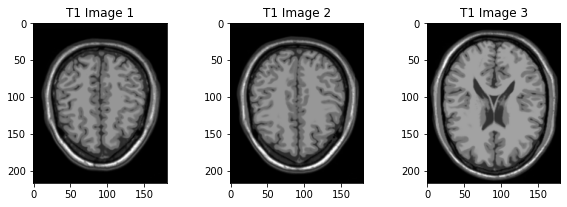

:------------------------------: 

T2 data examples


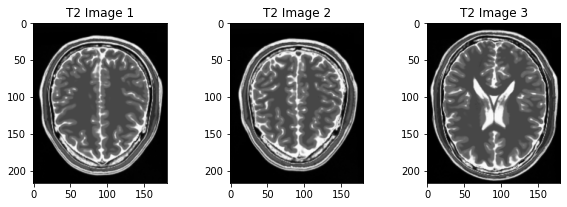

In [57]:
# Visualizing data from T1 dataset 
plt.figure(figsize=(10, 10))

# Iterate over the images 
for images in images_T1.take(1):
    print("T1 data examples")
    
    # Display only three images
    for i in range(3):
        # Create subplots in a 3x3 grid
        ax = plt.subplot(3, 3, i + 1)
        
        # Display the T1 image
        plt.imshow(images[i].numpy().astype("uint8"), cmap='gray')
        
        # Set title for the subplot
        plt.title(f'T1 Image {i + 1}')
        
        # Set axis properties 
        plt.axis

# Show the plot
plt.show()

print(":------------------------------:","\n")

# Visualizing data from T2 dataset 
plt.figure(figsize=(10, 10))

# Iterate over the images 
for images in images_T2.take(1):
    print("T2 data examples")
    
    # Display only three images
    for i in range(3):
        # Create subplots in a 3x3 grid
        ax = plt.subplot(3, 3, i + 1)
        
        # Display the T2 image
        plt.imshow(images[i].numpy().astype("uint8"), cmap='gray')
        
        # Set title for the subplot
        plt.title(f'T2 Image {i + 1}')
        
        # Set axis properties 
        plt.axis

# Show the plot
plt.show()

####  4. Pixel Value Range
We also explore the pixel value ranges of the images to understand the data distribution.

In [58]:
# Get the next batch of T1 images
image_batch = next(iter(images_T1))

# Select the first image from the batch
first_image = image_batch[0]

# Print information about the pixel value range of the T1 data
print("T1 data pixel value range Min:: ", np.min(first_image),"\n") # Minimum pixel value

print("T1 data pixel value range Max:: ", np.max(first_image),"\n") # Maximum pixel value

T1 data pixel value range Min::  0.0 

T1 data pixel value range Max::  255.0 



In [59]:
# Get the next batch of T2 images
image_batch = next(iter(images_T2))

# Select the first image from the batch
first_image = image_batch[0]

# Print information about the pixel value range of the T2 data
print("T2 data pixel value range Min:: ", np.min(first_image),"\n")  # Minimum pixel value

print("T2 data pixel value range Max:: ", np.max(first_image),"\n")  # Maximum pixel value



T2 data pixel value range Min::  0.0 

T2 data pixel value range Max::  255.0 



## Image Processing

In this section, we perform image processing on the MRI dataset to prepare the images for training our generative model.

### Normalization Function

Normalization is a preprocessing step commonly used in machine learning to scale numerical features to a standard range. For the purpose of this project, we'll normalize the pixel values of MRI images to the range [-1.0, 1.0]. This normalization helps stabilize and speed up the training process of deep learning models.


In [60]:
# for Define normalization function i.e Normalizing data in the range [-1.0, 1.0]
normalization_layer = layers.experimental.preprocessing.Rescaling(scale=1./127.5, offset=-1.0)

# Normalizing T1 data
images_T1_norm = images_T1.map(lambda x: normalization_layer(x))
image_batch1 = next(iter(images_T1_norm))
first_image = image_batch1[0]

# Print the minimum and maximum pixel values after normalization for T1 data
print("maximum pixel values after normalization for T1: ", np.max(first_image))

print("minimum pixel values after normalization for T1: ", np.min(first_image))


# Accessing the shape of the normalized T1 image
normalized_image_shape_T1 = next(iter(images_T1_norm))[0].shape
print("Shape of the normalized T1 image:", normalized_image_shape_T1)

print("->--->---","\n")

# Normalizing T2 data
images_T2_norm = images_T2.map(lambda x: normalization_layer(x))
image_batch2 = next(iter(images_T2_norm))
first_image = image_batch2[0]

# Print the minimum and maximum pixel values after normalization for T2 data
print("maximum pixel values after normalization for T2: ", np.max(first_image))

print("minimum pixel values after normalization for T2: ", np.min(first_image))

# Accessing the shape of the normalized T2 image
normalized_image_shape_T2 = next(iter(images_T2_norm))[0].shape
print("Shape of the normalized T2 image:", normalized_image_shape_T2)


maximum pixel values after normalization for T1:  1.0
minimum pixel values after normalization for T1:  -1.0
Shape of the normalized T1 image: (217, 181, 3)
->--->--- 

maximum pixel values after normalization for T2:  1.0
minimum pixel values after normalization for T2:  -1.0
Shape of the normalized T2 image: (217, 181, 3)


T1 after normalization


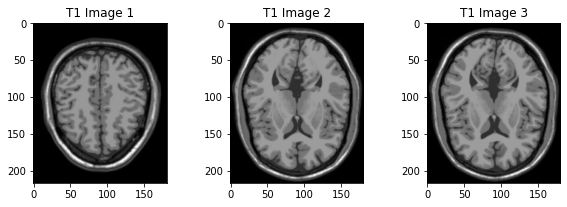

:------------------------------: 

T2 after normalization


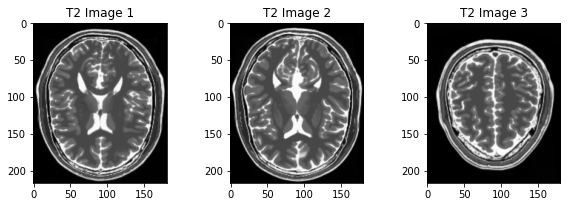

In [61]:
# Visualizing data from T1 dataset after normalization
plt.figure(figsize=(10, 10))

# Iterate over the images in the normalized T1 dataset
for images in images_T1_norm.take(1):
    print("T1 after normalization")
    
    # Display only three images
    for i in range(3):
        # Create subplots in a 3x3 grid
        ax = plt.subplot(3, 3, i + 1)
        
        # Display the normalized T1 image
        plt.imshow((images[i] * 127.5 + 127.5).numpy().astype("uint8"), cmap='gray')
        
        # Set title for the subplot
        plt.title(f'T1 Image {i + 1}')
        
        # Set axis properties 
        plt.axis

# Show the plot
plt.show()

print(":------------------------------:","\n")

# Visualizing data from T2 dataset after normalization
plt.figure(figsize=(10, 10))

# Iterate over the images in the normalized T1 dataset
for images in images_T2_norm.take(1):
    print("T2 after normalization")
    
    # Display only three images
    for i in range(3):
        # Create subplots in a 3x3 grid
        ax = plt.subplot(3, 3, i + 1)
        
        # Display the normalized T1 image
        plt.imshow((images[i] * 127.5 + 127.5).numpy().astype("uint8"), cmap='gray')
        
        # Set title for the subplot
        plt.title(f'T2 Image {i + 1}')
        
        # Set axis properties 
        plt.axis

# Show the plot
plt.show()

### Resizing Function

Resizing is a common image processing step used to adjust the dimensions of images in a dataset. In this context, we create a function to resize images to a specified height and width.

In [62]:
# Define resizing function using Resizing layer
resize_layer = layers.experimental.preprocessing.Resizing(128, 128, interpolation='bilinear')

# Resizing T1 data
images_T1_resized = images_T1_norm.map(lambda x: resize_layer(x))

# Obtaining a batch of T1 data.
image_batch_T1 = next(iter(images_T1_resized))
first_image_T1 = image_batch_T1[0]  

# Accessing the shape of the resized T1 image
resized_image_shape_T1 = first_image_T1.shape
print("Shape of the resized T1 image:", resized_image_shape_T1)

print("->--->---","\n")

# Resizing T2 data
images_T2_resized = images_T2_norm.map(lambda x: resize_layer(x))

# Obtaining a batch of T2 data.
image_batch_T2 = next(iter(images_T2_resized))
first_image_T2 = image_batch_T2[0]  

# Accessing the shape of the resized T2 image
resized_image_shape_T2 = first_image_T2.shape
print("Shape of the resized T2 image:", resized_image_shape_T2)


Shape of the resized T1 image: (128, 128, 3)
->--->--- 

Shape of the resized T2 image: (128, 128, 3)


T1 after resizing


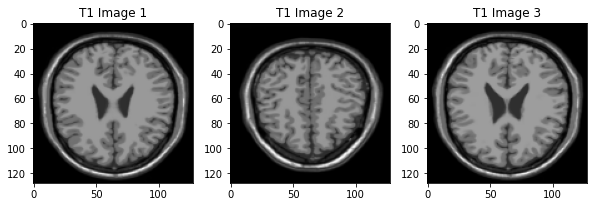

:------------------------------: 

T2 after resizing


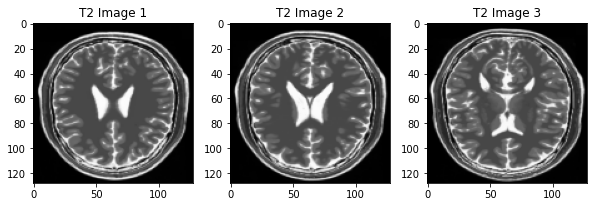

In [63]:
# Visualizing data from T1 dataset after resizing
plt.figure(figsize=(10, 10))

# Iterate over the images in the resized T1 dataset
for images in images_T1_resized.take(1):
    print("T1 after resizing")
    
    # Display only three images
    for i in range(3):
        # Create subplots in a 3x3 grid
        ax = plt.subplot(3, 3, i + 1)
        
        # Display the resized T1 image
        plt.imshow((images[i] * 127.5 + 127.5).numpy().astype("uint8"), cmap='gray')
        
        # Set title for the subplot
        plt.title(f'T1 Image {i + 1}')
        
        # Set axis properties 
        plt.axis

# Show the plot
plt.show()

print(":------------------------------:","\n")

# Visualizing data from T2 dataset after resizing
plt.figure(figsize=(10, 10))

# Iterate over the images in the resized T2 dataset
for images in images_T2_resized.take(1):
    print("T2 after resizing")
    
    # Display only three images
    for i in range(3):
        # Create subplots in a 3x3 grid
        ax = plt.subplot(3, 3, i + 1)
        
        # Display the resized T2 image
        plt.imshow((images[i] * 127.5 + 127.5).numpy().astype("uint8"), cmap='gray')
        
        # Set title for the subplot
        plt.title(f'T2 Image {i + 1}')
        
        # Set axis properties 
        plt.axis

# Show the plot
plt.show()


### Reshaping Function

Reshaping is a crucial step when preparing image data for deep learning models, especially when constructing neural networks. In this context, we create a function to reshape images to a desired target shape.


In [64]:
# Define reshaping function using Reshape layer
reshape_layer = layers.Reshape((128, 128, 1))

# Reshaping T1 data
images_T1_reshaped = images_T1_resized.map(lambda x: reshape_layer(x[:, :, :, 0]))

# Obtaining a batch of reshaped T1 data.
image_batch_T1_reshaped = next(iter(images_T1_reshaped))
first_image_T1_reshaped = image_batch_T1_reshaped[0]  

# Accessing the shape of the reshaped T1 image
reshaped_image_shape_T1 = first_image_T1_reshaped.shape
print("Shape of the reshaped T1 image:", reshaped_image_shape_T1)

# Printing a separator line
print("->--->---","\n")

# Reshaping T2 data
images_T2_reshaped = images_T2_resized.map(lambda x: reshape_layer(x[:, :, :, 0]))

# Obtaining a batch of reshaped T2 data.
image_batch_T2_reshaped = next(iter(images_T2_reshaped))
first_image_T2_reshaped = image_batch_T2_reshaped[0]  

# Accessing the shape of the reshaped T2 image
reshaped_image_shape_T2 = first_image_T2_reshaped.shape
print("Shape of the reshaped T2 image:", reshaped_image_shape_T2)



Shape of the reshaped T1 image: (128, 128, 1)
->--->--- 

Shape of the reshaped T2 image: (128, 128, 1)


T1 after reshaping


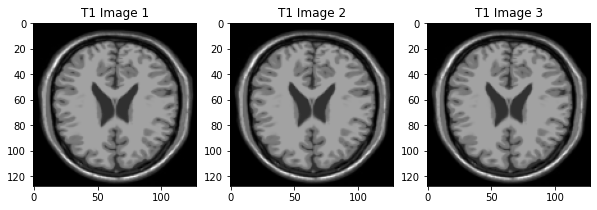

:------------------------------: 

T2 after reshaping


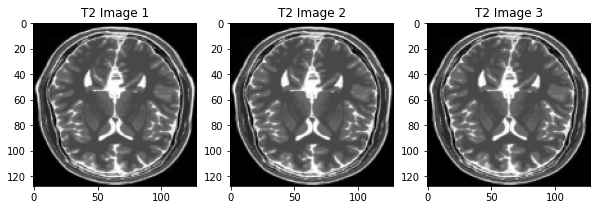

In [65]:
# Print statement for T1 dataset after reshaping
print("T1 after reshaping")

# Visualizing data from T1 dataset after reshaping
plt.figure(figsize=(10, 3))
for i in range(3):
    ax = plt.subplot(1, 3, i + 1)
    
    # Displaying T1 image using matplotlib
    plt.imshow(first_image_T1_reshaped.numpy()[:, :, 0], cmap='gray')  
    
    # Adding title to the subplot
    plt.title(f'T1 Image {i + 1}')
    
    # Setting the axis properties
    plt.axis

# Display the T1 images
plt.show()

# Separator line for better readability
print(":------------------------------:","\n")

# Print statement for T2 dataset after reshaping
print("T2 after reshaping")

# Visualizing data from T2 dataset after reshaping
plt.figure(figsize=(10, 3))
for i in range(3):
    ax = plt.subplot(1, 3, i + 1)
    
    # Displaying T2 image using matplotlib
    plt.imshow(first_image_T2_reshaped.numpy()[:, :, 0], cmap='gray')  
    
    # Adding title to the subplot
    plt.title(f'T2 Image {i + 1}')
    
    # Setting the axis properties
    plt.axis

# Display the T2 images
plt.show()


### Shuffling Data

Shuffling is an essential step in the preparation of a dataset for training machine learning models. It ensures that the order of examples does not influence the learning process, preventing any unintentional biases. In this context, we apply shuffling to the T1 and T2 datasets.


In [66]:
# Set the buffer size for shuffling
BUFFER_SIZE = 64

In [67]:
# Shuffling the data for T1 images
# This will help in introducing randomness to the order of the images
T1_data = images_T1_reshaped.shuffle(
    seed=42,        # Seed for reproducibility
    buffer_size=BUFFER_SIZE  # Size of the buffer used for shuffling
)

# Shuffling the data for T2 images
# This is done separately from T1 to maintain the order consistency between T1 and T2
T2_data = images_T2_reshaped.shuffle(
    seed=42,        # Same seed for consistency
    buffer_size=BUFFER_SIZE  # Same buffer size for consistency
)


In [68]:
# Obtaining a batch of T1 data.
sample_T1_data = next(iter(T1_data))  
print("T1 post Shuffling")
print("Shape of T1 image batch: ", sample_T1_data.shape)

# Extracting the shape of individual images in the batch.
first_image = sample_T1_data[0]
print("Shape of individual images in T1 batch: ", first_image.shape, "\n")

print('-->--->',"\n")

# Obtaining a batch of T2 data.
sample_T2_data = next(iter(T2_data))  
print("T2 post Shuffling")
print("Shape of T2 image batch: ", sample_T2_data.shape)

# Extracting the shape of individual images in the batch.
first_image = sample_T2_data[0]
print("Shape of individual images in T2 batch: ", first_image.shape, "\n")


T1 post Shuffling
Shape of T1 image batch:  (43, 128, 128, 1)
Shape of individual images in T1 batch:  (128, 128, 1) 

-->---> 

T2 post Shuffling
Shape of T2 image batch:  (46, 128, 128, 1)
Shape of individual images in T2 batch:  (128, 128, 1) 



T1 after shuffling


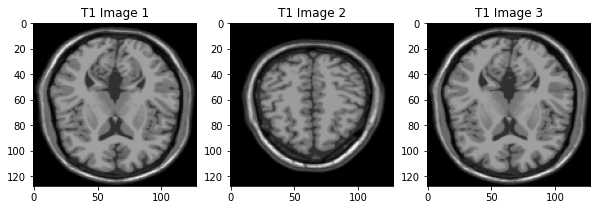

:------------------------------: 

T2 after shuffling


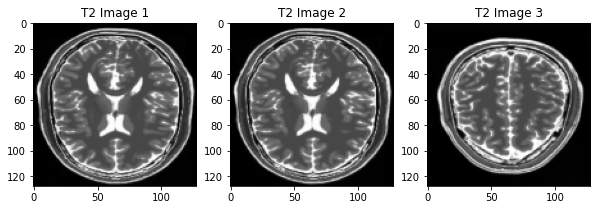

In [69]:
# Print statement for T1 dataset after shuffling
print("T1 after shuffling")

# Visualizing data from T1 dataset after shuffling
plt.figure(figsize=(10, 3))
for i in range(3):
    ax = plt.subplot(1, 3, i + 1)
    
    # Displaying T1 image using matplotlib
    plt.imshow(sample_T1_data[i].numpy()[:, :, 0], cmap='gray')  
    
    # Adding title to the subplot
    plt.title(f'T1 Image {i + 1}')
    
    # Setting the axis properties
    plt.axis

# Display the T1 images
plt.show()

# Separator line for better readability
print(":------------------------------:","\n")

# Print statement for T2 dataset after shuffling
print("T2 after shuffling")

# Visualizing data from T2 dataset after shuffling
plt.figure(figsize=(10, 3))
for i in range(3):
    ax = plt.subplot(1, 3, i + 1)
    
    # Displaying T2 image using matplotlib
    plt.imshow(sample_T2_data[i].numpy()[:, :, 0], cmap='gray')  
    
    # Adding title to the subplot
    plt.title(f'T2 Image {i + 1}')
    
    # Setting the axis properties
    plt.axis

# Display the T2 images
plt.show()

## Model-Building and Training

In this section, we focus on constructing the Generative Adversarial Model using a modified U-Net architecture, similar to CycleGAN. The primary goal is to create Generators and Discriminators tailored for the specific task of generating artificial MRI images of different contrast levels from existing MRI scans.

### Generative Adversarial Model

- **U-Net Architecture:** A modified U-Net architecture is employed for the Generators. U-Net is known for its ability to capture fine details and is widely used in image-to-image translation tasks.

- **CycleGAN Concept:** Inspired by CycleGAN, the model utilizes the idea of cycle consistency, translating the style of one MRI image to another to achieve better understanding of the scanned image.

### Model Training

- **Loss Function Definition:** A specific loss function is defined for the training process, guiding the model to generate realistic images while minimizing the discrepancies between the translated and original images.

- **Training Steps:** The training step involves optimizing the Generators and Discriminators using backpropagation, updating the weights to improve the model's performance.

Now, let's proceed with defining the custom Instance Normalization Layer.


### Instance Normalization Layer

This code defines a custom Instance Normalization layer in TensorFlow. Instance Normalization is a normalization technique commonly used in neural networks, especially in image processing tasks. The layer is implemented as a custom class `InstanceNormalization` and inherits from `tf.keras.layers.Layer`. It includes the following key components:

- **Initialization:** The layer is initialized with an epsilon value to handle numerical stability.

- **Building:** The `build` method is used to define the weights of the layer. It includes trainable scale and offset parameters for scaling and shifting the normalized values.

- **Forward Pass:** The `call` method defines the forward pass of the layer. It computes the mean and variance of the input tensor along specified axes (Instance Normalization). The input tensor is then normalized, scaled, and shifted using the trainable parameters.

This custom Instance Normalization layer can be integrated into a neural network for tasks such as image style transfer or generative modeling.


In [70]:
# Instance Normalization Layer
class InstanceNormalization(tf.keras.layers.Layer):
    def __init__(self, epsilon=1e-5):
        # Initialize the InstanceNormalization layer with an epsilon value
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon

    def build(self, input_shape):
        # Build method is used to define the weights of the layer
        # Add a trainable scale parameter for scaling the normalized values
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True
        )
        # Add a trainable offset parameter for shifting the normalized values
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True
        )

    def call(self, x):
        # Call method is used to define the forward pass of the layer
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        
        # Compute the inverse square root of the variance with epsilon for numerical stability
        inv = tf.math.rsqrt(variance + self.epsilon)
        
        # Normalize the input tensor
        normalized = (x - mean) * inv
        
        # Scale and shift the normalized tensor using trainable parameters
        return self.scale * normalized + self.offset


### Downsampling Function for Convolutional Neural Network

This code defines a function `downsample` used in a convolutional neural network (CNN) for downsampling. The function creates a downsample block, which typically involves a Convolutional layer, Instance Normalization, and Leaky ReLU activation. Key components of the function include:

- **Conv2D Layer:** Utilizes a Convolutional layer for downsampling, specifying the number of filters, filter size, stride, and kernel initializer.

- **Instance Normalization:** An optional Instance Normalization layer can be applied to normalize the activations, contributing to the stability and performance of the neural network.

- **Leaky ReLU Activation:** Implements Leaky Rectified Linear Unit (ReLU) activation, introducing non-linearity in the network.

This function is commonly used in building the downsampling part of a U-Net or similar architectures, contributing to the hierarchical feature extraction in CNNs.



In [71]:
# Define a function for downsampling in a convolutional neural network
def downsample(filters, size, apply_norm=True):
    # Initialize the weights using a random normal distribution
    initializer = tf.random_normal_initializer(0., 0.02)
    
    # Create a sequential model to represent the downsample block
    result = tf.keras.Sequential()

    # Add Conv2D layer for downsampling
    result.add(
        tf.keras.layers.Conv2D(
            filters,                  # Number of filters
            size,                     # Filter size
            strides=2,                # Stride for downsampling
            padding='same',           # Padding to maintain spatial dimensions
            kernel_initializer=initializer,  # Initialize kernel weights
            use_bias=False            # Disable bias in Conv2D
        )
    )

    # Add Instance Normalization layer 
    if apply_norm:
        result.add(InstanceNormalization())  

    # Add Leaky ReLU activation function
    result.add(tf.keras.layers.LeakyReLU())

    return result

### Upsampling Function for Convolutional Neural Network

This code defines a function `upsample` used in a convolutional neural network (CNN) for upsampling. The function creates an upsampling block, which typically involves a Transposed Convolutional layer, Instance Normalization, optional Dropout, and ReLU activation. Key components of the function include:

- **Conv2DTranspose Layer:** Utilizes a Transposed Convolutional layer for upsampling, specifying the number of filters, kernel size, stride, and weight initializer.

- **Instance Normalization:** Applies Instance Normalization to normalize the activations, enhancing stability and performance.

- **Dropout (Optional):** Conditionally adds a Dropout layer to prevent overfitting. The dropout rate is set to 0.5 if specified.

- **ReLU Activation:** Implements Rectified Linear Unit (ReLU) activation, introducing non-linearity in the network.

This function is commonly used in building the upsampling part of a U-Net or similar architectures, contributing to the generation of high-resolution images from low-resolution feature maps.


In [72]:
# Define a function for upsampling
def upsample(filters, size, apply_dropout=False):
    # Use a normal distribution for weight initialization
    initializer = tf.random_normal_initializer(0., 0.02)

    # Create a sequential model for the upsampling block
    result = tf.keras.Sequential()

    # Add Transposed Conv2d layer for upsampling
    result.add(
        tf.keras.layers.Conv2DTranspose(
            filters,          # Number of filters
            size,             # Kernel size
            strides=2,        # Stride for upsampling
            padding='same',   # Padding to maintain spatial dimensions
            kernel_initializer=initializer,  # Weight initializer
            use_bias=False     # Disable bias in Conv2DTranspose
        )
    )

    # Add Instance Normalization Layer
    result.add(InstanceNormalization())

    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    # Add Rectified Linear Unit (ReLU) Activation Layer
    result.add(tf.keras.layers.ReLU())

    return result


#### U-Net Generator Model

This code defines a U-Net generator model, a type of architecture commonly used in image-to-image translation tasks. The U-Net generator consists of a downsampling path, an upsampling path, and skip connections to capture both global and local features. Key components of the function include:

- **Downsample Stack:** Sequential downsample layers to extract hierarchical features, each with Conv2D, Instance Normalization, and Leaky ReLU activation.

- **Upsample Stack:** Sequential upsample layers to reconstruct the image, each with Conv2DTranspose, Instance Normalization, optional Dropout, and ReLU activation.

- **Concatenation:** Concatenation operation to combine feature maps from the downsampling path and upsampling path.

- **Final Convolution Layer:** Conv2DTranspose layer with Tanh activation for the final output.

- **Input and Output:** Input layer with shape [128, 128, 1], and the output is the generated image.

This U-Net generator model is designed for tasks such as style transfer and image generation, providing a powerful tool for learning complex mappings between images.


In [73]:
def unet_generator():
    """
    Function to create a U-Net generator model.
    Returns:
        tf.keras.Model: U-Net generator model.
    """
    # Define the downsample stack
    down_stack = [
        downsample(128, 4, apply_norm=False),  # Initial downsample layer without normalization
        downsample(128, 4),  # Downsample layer with normalization
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
    ]

    # Define the upsample stack
    up_stack = [
        upsample(512, 4, apply_dropout=True),  # Upsample layer with dropout
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(128, 4),
    ]

    # Initialize the weights with a random normal distribution
    initializer = tf.random_normal_initializer(0.0, 0.02)
    
    # Define the final convolution layer
    last = tf.keras.layers.Conv2DTranspose(
        1,
        4,
        strides=2,
        padding="same",
        kernel_initializer=initializer,
        activation="tanh",
    )

    # Concatenate operation to combine feature maps during upsampling
    concat = tf.keras.layers.Concatenate()

    # Define the input layer
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    # Reverse the skips list for correct order during upsampling
    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])

    # Final convolutional layer
    x = last(x)
    
    # Create and return the U-Net generator model
    return tf.keras.Model(inputs=inputs, outputs=x)


In [74]:
# Define a U-Net generator for generating T2 images using T1 MRI scans
generator_T1 = unet_generator()

# Define another U-Net generator for generating T1 images using T2 MRI scans
generator_T2 = unet_generator()

In [75]:
# Visualize the architecture of the generator model
# show_shapes=True: Displays the shapes of the layers in the plot
# show_layer_names=True: Displays the names of the layers in the plot
plot_model(generator_T1, show_shapes=True, show_layer_names=True)

('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [76]:
# Display a summary of the generator_T1 model architecture
# The summary provides a concise representation of the model's layers and parameters
generator_T1.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential_36 (Sequential)     (None, 64, 64, 128)  2048        ['input_3[0][0]']                
                                                                                                  
 sequential_37 (Sequential)     (None, 32, 32, 128)  262400      ['sequential_36[0][0]']          
                                                                                                  
 sequential_38 (Sequential)     (None, 16, 16, 256)  524800      ['sequential_37[0][0]']    

In [77]:
# Visualize the architecture of the generator model
# show_shapes=True: Displays the shapes of the layers in the plot
# show_layer_names=True: Displays the names of the layers in the plot
plot_model(generator_T2, show_shapes=True, show_layer_names=True)

('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [78]:
# Display a summary of the generator_T2 model architecture
# The summary provides a concise representation of the model's layers and parameters
generator_T2.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential_50 (Sequential)     (None, 64, 64, 128)  2048        ['input_4[0][0]']                
                                                                                                  
 sequential_51 (Sequential)     (None, 32, 32, 128)  262400      ['sequential_50[0][0]']          
                                                                                                  
 sequential_52 (Sequential)     (None, 16, 16, 256)  524800      ['sequential_51[0][0]']    

#### Discriminator Architecture

This code defines the architecture for the discriminator model, a crucial component in the Generative Adversarial Network (GAN). The discriminator's role is to distinguish between real and generated images. Key elements of the architecture include:

- **Input Layer:** The model starts with an input layer expecting images of shape (128, 128, 1).

- **Downsampling Layers:** Sequential downsample layers that progressively reduce spatial dimensions while increasing the number of filters, capturing hierarchical features.

- **Zero-padding Layers:** These layers introduce zero-padding to maintain spatial dimensions during convolution operations.

- **Convolutional Layers:** Convolutional layers with Leaky ReLU activation and Instance Normalization, contributing to feature extraction and stability.

- **Final Convolutional Layer:** The last convolutional layer produces a single-channel output, determining whether the input image is real or generated.

This discriminator architecture is designed to effectively discriminate between real and generated images in the GAN training process.


In [79]:
# Discriminator architecture:
# The discriminator contains only Convolutional layers with no Transposed Convolution used.

def discriminator():
    # Initialization using a normal distribution with mean 0 and standard deviation 0.02
    initializer = tf.random_normal_initializer(0., 0.02)
    
    # Input layer with shape (128, 128, 1)
    inp = tf.keras.layers.Input(shape=[128, 128, 1], name='input_image')
    x = inp

    # Downsampling layers
    down1 = downsample(64, 4, False)(x)                 # Output shape: (batch_size, 64, 64, 64)
    down2_intermediate = downsample(128, 4)(down1)      # Output shape: (batch_size, 32, 32, 128)
    down3_intermediate = downsample(256, 4)(down2_intermediate)  # Output shape: (batch_size, 16, 16, 256)
    down4 = downsample(512, 4)(down3_intermediate)      # Output shape: (batch_size, 8, 8, 512)

    # Zero-padding layer
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down4)  # Output shape: (batch_size, 10, 10, 512)

    # Convolutional layer with 256 filters, kernel size 4, and Leaky ReLU activation
    conv = tf.keras.layers.Conv2D(256, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1)  # Output shape: (batch_size, 7, 7, 256)
    norm1 = InstanceNormalization()(conv)               # Apply Instance Normalization
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)      # Apply Leaky ReLU activation

    # Another zero-padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)   # Output shape: (batch_size, 9, 9, 256)

    # Final Convolutional layer with 1 filter and kernel size 4
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2)   # Output shape: (batch_size, 6, 6, 1)

    # Define the discriminator model with input and output
    return tf.keras.Model(inputs=inp, outputs=last)


In [80]:
# Instantiating discriminators for tasks T1 and T2
# Creating an instance of the discriminator class for task T1
discriminator_T1 = discriminator()

# Creating another instance of the discriminator class for task T2
discriminator_T2 = discriminator()


In [81]:
# Visualize discriminator model architecture
# 'plot_model' function is used to generate a plot of the model architecture
# show_shapes=True: displays the shape of the output tensors at each layer
# show_layer_names=True: displays the names of the layers in the plot

plot_model(discriminator_T1, show_shapes=True, show_layer_names=True)


('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [82]:
# Display a summary of the discriminator_T1 model architecture
# The summary provides a concise representation of the model's layers and parameters
discriminator_T1.summary()

Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 128, 128, 1)]     0         
                                                                 
 sequential_64 (Sequential)  (None, 64, 64, 64)        1024      
                                                                 
 sequential_65 (Sequential)  (None, 32, 32, 128)       131328    
                                                                 
 sequential_66 (Sequential)  (None, 16, 16, 256)       524800    
                                                                 
 sequential_67 (Sequential)  (None, 8, 8, 512)         2098176   
                                                                 
 zero_padding2d_4 (ZeroPaddi  (None, 10, 10, 512)      0         
 ng2D)                                                           
                                                           

In [83]:
# Visualize discriminator model architecture
# 'plot_model' function is used to generate a plot of the model architecture
# show_shapes=True: displays the shape of the output tensors at each layer
# show_layer_names=True: displays the names of the layers in the plot

plot_model(discriminator_T2, show_shapes=True, show_layer_names=True)

('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [84]:
# Display a summary of the discriminator_T2 model architecture
# The summary provides a concise representation of the model's layers and parameters
discriminator_T2.summary()

Model: "model_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 128, 128, 1)]     0         
                                                                 
 sequential_68 (Sequential)  (None, 64, 64, 64)        1024      
                                                                 
 sequential_69 (Sequential)  (None, 32, 32, 128)       131328    
                                                                 
 sequential_70 (Sequential)  (None, 16, 16, 256)       524800    
                                                                 
 sequential_71 (Sequential)  (None, 8, 8, 512)         2098176   
                                                                 
 zero_padding2d_6 (ZeroPaddi  (None, 10, 10, 512)      0         
 ng2D)                                                           
                                                           

#### Output of Untrained Generator Models

This code demonstrates the output of untrained generator models, specifically from T1 data to T2 data and vice versa. The process involves:

1. **Generate T2 Data from T1 Data:**
   - Retrieve a sample from the T1 data dataset (`sample_T1_data`).
   - Apply the generator function (`generator_T2`) to convert the T1 data to T2 data (`to_T2_data`).

2. **Generate T1 Data from T2 Data:**
   - Retrieve a sample from the T2 data dataset (`sample_T2_data`).
   - Apply the generator function (`generator_T1`) to convert the T2 data to T1 data (`to_T1_data`).

3. **Visualize the Outputs:**
   - Display the original and generated images side by side for both T1 to T2 and T2 to T1 conversions.
   - The untrained generator models are expected to produce random noise rather than meaningful images at this stage.

This visualization provides insights into the initial output of the generator models before any training has taken place.


In [85]:
#Check output of Untrained Generator models which should be a random noise

In [86]:
# Retrieve a sample from the T1_data dataset
sample_T1_data = next(iter(T1_data))

# Assume generator_T2 is a function that generates T2 data from T1 data
# Apply the generator function to the sample_T1_data to obtain T2 data
to_T2_data = generator_T2(sample_T1_data)


# Retrieve a sample from the T2_data dataset
sample_T2_data = next(iter(T2_data))

# Assume generator_T1 is a function that generates T1 data from T2 data
# Apply the generator function to the sample_T2_data to obtain T1 data
to_T1_data = generator_T1(sample_T2_data)

T1_data To T2_data 



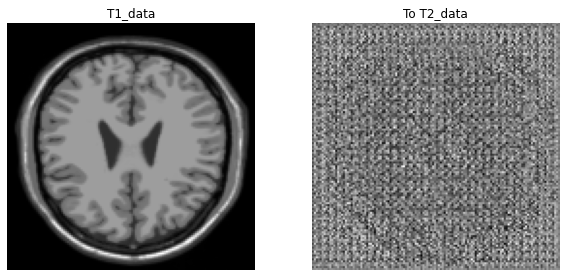

-->--- 

T2_data To T1_data 



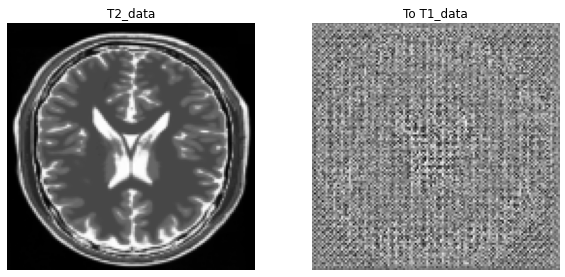

In [87]:
# Visualize the output of Untrained Generator models, which is expected to exhibit random noise
#T1_data To T2_data

print("T1_data To T2_data","\n")
plt.figure(figsize=(10, 10))

# List of images and corresponding titles
imgs = [sample_T1_data, to_T2_data]
title = ['T1_data', 'To T2_data']

# Loop through each image
for i in range(len(imgs)):
    # Create subplots in a 2x2 grid
    plt.subplot(2, 2, i+1)

    # Set the title for the subplot
    plt.title(title[i])

    # Display the image using imshow
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')

    # Turn off axis for better visualization
    plt.axis('off')

# Show the plot
plt.show()

print("-->---","\n")

#T2_data To T1_data

print("T2_data To T1_data","\n")
plt.figure(figsize=(10, 10))

# List of images and corresponding titles
imgs = [sample_T2_data, to_T1_data]
title = ['T2_data', 'To T1_data']

# Loop through each image
for i in range(len(imgs)):
    # Create subplots in a 2x2 grid
    plt.subplot(2, 2, i+1)

    # Set the title for the subplot
    plt.title(title[i])

    # Display the image using imshow
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')

    # Turn off axis for better visualization
    plt.axis('off')

# Show the plot
plt.show()

In [88]:
# Print the shape of sample_T1_data
print("Shape of sample_T1_data:", sample_T1_data.shape)

# Print the shape of sample_T2_data
print("Shape of sample_T2_data:", sample_T2_data.shape)

Shape of sample_T1_data: (43, 128, 128, 1)
Shape of sample_T2_data: (46, 128, 128, 1)


#### Binary Cross Entropy Loss Function

This code creates an instance of the Binary Cross Entropy loss function for a binary classification task. The loss function is configured with `from_logits=True`, indicating that the model outputs are logits, representing raw predictions before the activation function. This loss function is commonly used in adversarial training scenarios, such as Generative Adversarial Networks (GANs), where binary classification is involved.


In [89]:
# Creating an instance of Binary Cross Entropy loss function
# Setting from_logits=True to indicate that the model outputs are logits, i.e., raw predictions before activation function
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Discriminator Loss Calculation Function

This code defines a function to calculate the discriminator loss in a Generative Adversarial Network (GAN). The function takes two sets of predictions as input, one for real images and another for generated (fake) images. It uses Binary Cross Entropy loss for both cases, assigning labels of 1 for real images and 0 for generated images. The total discriminator loss is the sum of the losses for real and generated images, scaled by 0.5. This function is crucial in training the discriminator of a GAN.


In [90]:
# Function to calculate the discriminator loss
def discriminator_loss(real, generated):
    # Loss for real images
    real_loss = loss_obj(tf.ones_like(real), real)
    
    # Loss for generated (fake) images
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    
    # Total discriminator loss is the sum of real and generated losses
    total_disc_loss = real_loss + generated_loss
    
    # Return the mean of the losses (scaled by 0.5)
    return total_disc_loss * 0.5


#### Generator Loss Calculation Function

This code defines a function to calculate the loss for the generator in a Generative Adversarial Network (GAN). The function takes the predictions generated by the generator as input and uses Binary Cross Entropy loss. It assigns labels of 1, indicating real, to the generated images. This loss function is crucial in training the generator of a GAN, encouraging it to produce images that are more difficult for the discriminator to distinguish from real images.


In [91]:
# Define the loss function for the generators
def generator_loss(generated):
    """
    This function calculates the loss for the generator.

    Parameters:
    - generated: The output generated by the generator.

    Returns:
    - The loss value for the generator.
    """
    return loss_obj(tf.ones_like(generated), generated)


#### Cycle Consistency Loss Calculation Function

This code defines a function to calculate the cycle consistency loss between a real image and its cycled version. The function computes the absolute element-wise difference between the real and cycled images and scales the result by a factor of 10.0. The cycle consistency loss is a crucial component in training CycleGANs, enforcing the generated images to maintain consistency across translation cycles.


In [92]:
# Cycle consistency loss function
def calc_cycle_loss(real_image, cycled_image):
    # Calculate the absolute element-wise difference between the real and cycled images
    cycle_loss = tf.reduce_mean(tf.abs(real_image - cycled_image))

    # Scale the cycle loss by a factor of 10.0 for better convergence
    # This scaling factor is often used to balance the importance of the cycle consistency term
    return 10.0 * cycle_loss


#### Identity Loss Calculation Function

This code defines a function to calculate the identity loss, which measures the absolute difference between a real image and its reconstructed version. The identity loss is an essential component in CycleGANs to encourage the generator to preserve the input image characteristics during translation. The loss is multiplied by 0.5 for balancing purposes.


In [93]:
# Define a function for identity loss
def identity_loss(real_image, same_image):
    # Calculate the absolute difference between the real and same images
    id_loss = tf.reduce_mean(tf.abs(real_image - same_image))

    # Multiply the identity loss by 0.5 for balancing
    return 0.5 * id_loss


#### Optimizer Configuration for Generators and Discriminators

This code sets up Adam optimizers for the generators and discriminators in a CycleGAN model. The learning rate is set to 2e-4, and the beta1 value is set to 0.5 for improved stability during training.


In [94]:
# Configuring optimizers for the generators and discriminators
# Setting up Adam optimizers with a learning rate of 2e-4 and a beta1 value of 0.5 for improved stability
generator_T1_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
generator_T2_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
discriminator_T1_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
discriminator_T2_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)

#### Checkpoint Configuration for Model Saving

This code ensures the existence of a directory for storing training checkpoints and creates one if it doesn't exist. It defines a checkpoint path for storing training checkpoints and sets up a TensorFlow checkpoint for saving the model's state during training. The Checkpoint Manager is employed to manage and keep track of checkpoints, and if a checkpoint exists, the latest checkpoint is restored to resume training.


In [95]:
# Ensure the directory for storing training checkpoints exists; create if not.
if not os.path.isdir('training_checkpoints'):
    os.mkdir('training_checkpoints')

# Define the path for storing training checkpoints.
checkpoint_path = "./training_checkpoints"

# Create a TensorFlow checkpoint for model saving during training.
ckpt = tf.train.Checkpoint(generator_T1=generator_T1,
                           generator_T2=generator_T2,
                           discriminator_T1=discriminator_T1,
                           discriminator_T2=discriminator_T2,
                           generator_T1_optimizer=generator_T1_optimizer,
                           generator_T2_optimizer=generator_T2_optimizer,
                           discriminator_T1_optimizer=discriminator_T1_optimizer,
                           discriminator_T2_optimizer=discriminator_T2_optimizer)

# Create a Checkpoint Manager to manage and keep track of checkpoints.
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# If a checkpoint exists, restore the latest checkpoint to resume training.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print('Latest checkpoint restored successfully!!')


#### Image Generation and Display during Training

This code ensures the existence of a directory for storing generated images for each epoch and creates one if it doesn't exist. The function `generate_images` is defined to generate predictions for domains T1 and T2 using the specified models and display the input and generated images in a 2x2 grid. The images are saved and displayed for each epoch during training.


In [96]:
# Ensure the directory exists to store generated images for each epoch
if not os.path.isdir('generated_images'):
    os.mkdir('generated_images')

# Function to display generated images during training
def generate_images(model1, test_input1, model2, test_input2, epoch):
    # Generate predictions for domain T1 and T2
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)

    # Set up the visualization layout
    plt.figure(figsize=(4, 4))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = [
        'Input T1',
        'Generated T2 - Epoch ' + str(epoch),
        'Input T2',
        'Generated T1 - Epoch ' + str(epoch)
    ]

    # Display images with titles and formatting
    for i in range(4):
        plt.subplot(2, 2, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    # Save and display the visualization
    plt.savefig('./generated_images/image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()


#### Training Step for Cycle-Consistent GAN Model

A training step for the cycle-consistent GAN (Generative Adversarial Network) model using TensorFlow. The `train_step` function implements the forward and backward passes, calculating the generator and discriminator losses, gradients, and applying optimizer updates. It utilizes generators, discriminators, and loss functions previously defined in the script.


In [97]:
# Train step function for the cycle-consistent GAN model using TensorFlow.

@tf.function
def train_step(real_T1, real_T2):
    # Set persistent to True as the tape is used more than once to calculate gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator T2 translates T1 -> T2
        # Generator T1 translates T2 -> T1
        fake_T2 = generator_T2(real_T1, training=True)
        cycled_T1 = generator_T1(fake_T2, training=True)

        fake_T1 = generator_T1(real_T2, training=True)
        cycled_T2 = generator_T2(fake_T1, training=True)

        # same_T1 and same_T2 are used for identity loss.
        same_T1 = generator_T1(real_T1, training=True)
        same_T2 = generator_T2(real_T2, training=True)

        disc_real_T1 = discriminator_T1(real_T1, training=True)
        disc_real_T2 = discriminator_T2(real_T2, training=True)

        disc_fake_T1 = discriminator_T1(fake_T1, training=True)
        disc_fake_T2 = discriminator_T2(fake_T2, training=True)

        # Calculate generator loss
        gen_T2_loss = generator_loss(disc_fake_T2)
        gen_T1_loss = generator_loss(disc_fake_T1)

        # Calculate cycle loss
        total_cycle_loss = calc_cycle_loss(real_T1, cycled_T1) + calc_cycle_loss(real_T2, cycled_T2)

        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_T1_loss = gen_T1_loss + total_cycle_loss + identity_loss(real_T1, same_T1)
        total_gen_T2_loss = gen_T2_loss + total_cycle_loss + identity_loss(real_T2, same_T2)

        # Discriminator's loss
        disc_T1_loss = discriminator_loss(disc_real_T1, disc_fake_T1)
        disc_T2_loss = discriminator_loss(disc_real_T2, disc_fake_T2)

    # Calculate the gradients for generator and discriminator
    generator_T1_gradients = tape.gradient(total_gen_T1_loss, generator_T1.trainable_variables)
    generator_T2_gradients = tape.gradient(total_gen_T2_loss, generator_T2.trainable_variables)

    discriminator_T1_gradients = tape.gradient(disc_T1_loss, discriminator_T1.trainable_variables)
    discriminator_T2_gradients = tape.gradient(disc_T2_loss, discriminator_T2.trainable_variables)

    # Apply the gradients to the optimizer
    generator_T1_optimizer.apply_gradients(zip(generator_T1_gradients, generator_T1.trainable_variables))
    generator_T2_optimizer.apply_gradients(zip(generator_T2_gradients, generator_T2.trainable_variables))

    discriminator_T1_optimizer.apply_gradients(zip(discriminator_T1_gradients, discriminator_T1.trainable_variables))
    discriminator_T2_optimizer.apply_gradients(zip(discriminator_T2_gradients, discriminator_T2.trainable_variables))


#### Nested Loop for Iterating Over Image Pairs in T1_data and T2_data

Demonstrates a nested loop to iterate over each image pair in `T1_data` and `T2_data`. It prints the shapes of the current images from `T1_data` and `T2_data` within the loop.


In [98]:
# Nested loop to iterate over each image in T1_data and T2_data
for image_x in T1_data:
    for image_y in T2_data:
        # Print the shapes of the current images from T1_data and T2_data
        print("Shape of image_x:", image_x.shape,'\n')
        print("Shape of image_y:", image_y.shape)
        


Shape of image_x: (43, 128, 128, 1) 

Shape of image_y: (46, 128, 128, 1)


#### Training Loop for Cycle-Consistent GAN Model

A training loop for a Cycle-Consistent GAN model. It iterates through a specified number of epochs, performing a training step for each image pair in the datasets `T1_data` and `T2_data`. Additionally, it generates and saves images using the trained generators for T2 and T1 domains after each epoch.


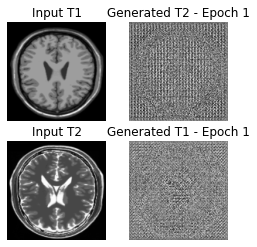

Saving checkpoint for epoch 1 at ./training_checkpoints/ckpt-1


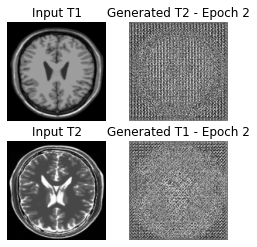

Saving checkpoint for epoch 2 at ./training_checkpoints/ckpt-2


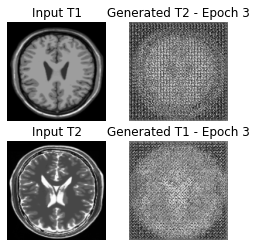

Saving checkpoint for epoch 3 at ./training_checkpoints/ckpt-3


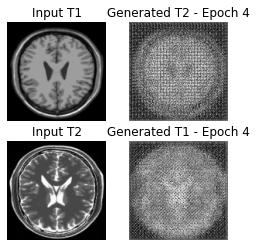

Saving checkpoint for epoch 4 at ./training_checkpoints/ckpt-4


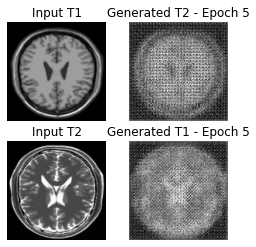

Saving checkpoint for epoch 5 at ./training_checkpoints/ckpt-5


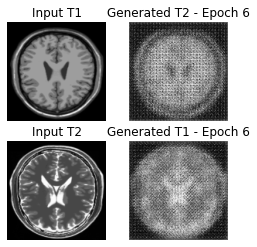

Saving checkpoint for epoch 6 at ./training_checkpoints/ckpt-6


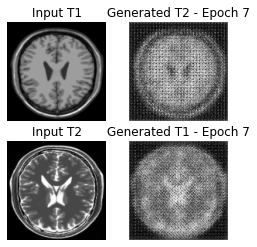

Saving checkpoint for epoch 7 at ./training_checkpoints/ckpt-7


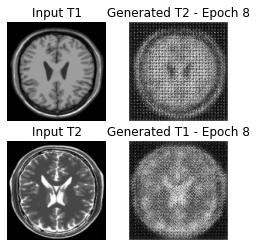

Saving checkpoint for epoch 8 at ./training_checkpoints/ckpt-8


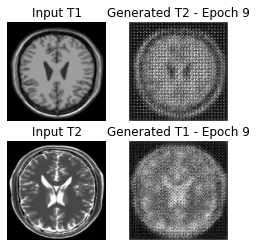

Saving checkpoint for epoch 9 at ./training_checkpoints/ckpt-9


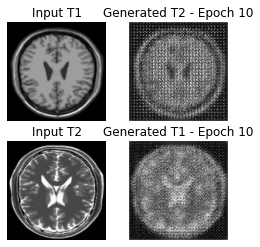

Saving checkpoint for epoch 10 at ./training_checkpoints/ckpt-10


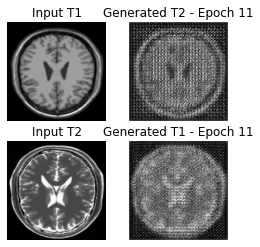

Saving checkpoint for epoch 11 at ./training_checkpoints/ckpt-11


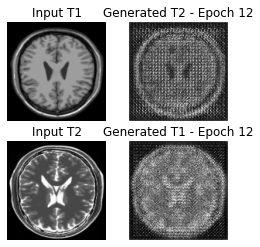

Saving checkpoint for epoch 12 at ./training_checkpoints/ckpt-12


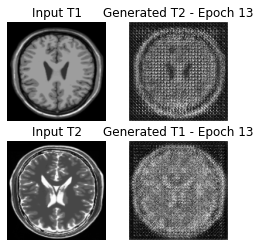

Saving checkpoint for epoch 13 at ./training_checkpoints/ckpt-13


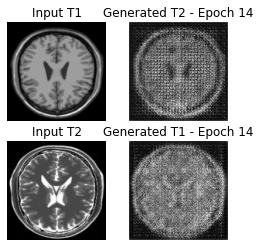

Saving checkpoint for epoch 14 at ./training_checkpoints/ckpt-14


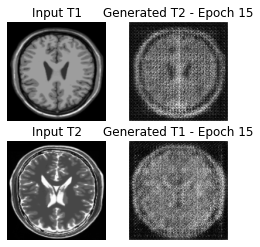

Saving checkpoint for epoch 15 at ./training_checkpoints/ckpt-15


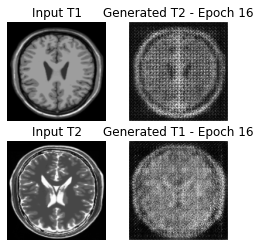

Saving checkpoint for epoch 16 at ./training_checkpoints/ckpt-16


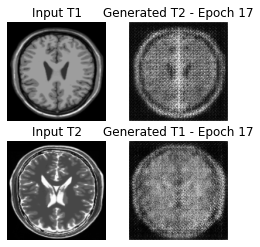

Saving checkpoint for epoch 17 at ./training_checkpoints/ckpt-17


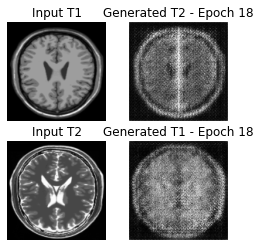

Saving checkpoint for epoch 18 at ./training_checkpoints/ckpt-18


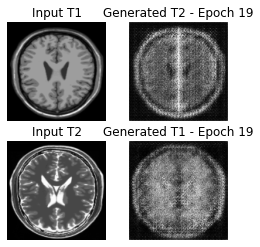

Saving checkpoint for epoch 19 at ./training_checkpoints/ckpt-19


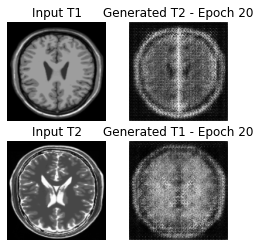

Saving checkpoint for epoch 20 at ./training_checkpoints/ckpt-20


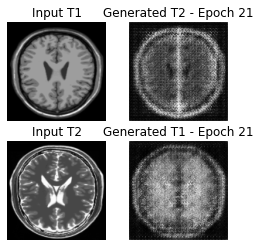

Saving checkpoint for epoch 21 at ./training_checkpoints/ckpt-21


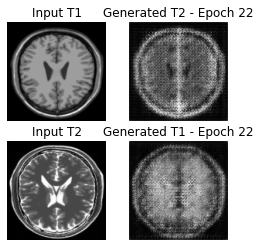

Saving checkpoint for epoch 22 at ./training_checkpoints/ckpt-22


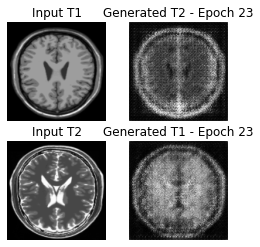

Saving checkpoint for epoch 23 at ./training_checkpoints/ckpt-23


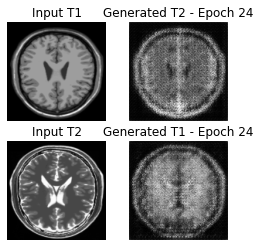

Saving checkpoint for epoch 24 at ./training_checkpoints/ckpt-24


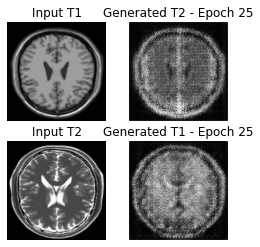

Saving checkpoint for epoch 25 at ./training_checkpoints/ckpt-25


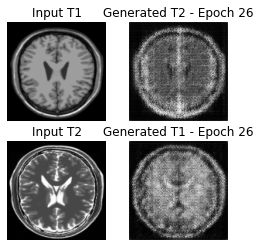

Saving checkpoint for epoch 26 at ./training_checkpoints/ckpt-26


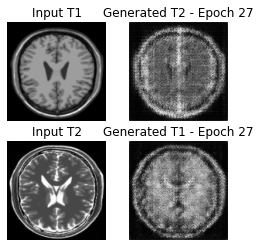

Saving checkpoint for epoch 27 at ./training_checkpoints/ckpt-27


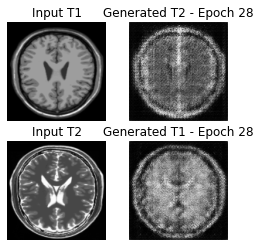

Saving checkpoint for epoch 28 at ./training_checkpoints/ckpt-28


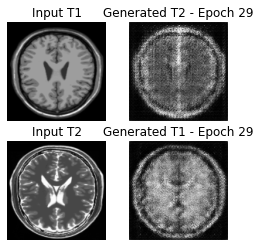

Saving checkpoint for epoch 29 at ./training_checkpoints/ckpt-29


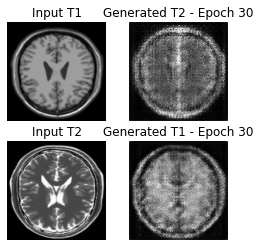

Saving checkpoint for epoch 30 at ./training_checkpoints/ckpt-30


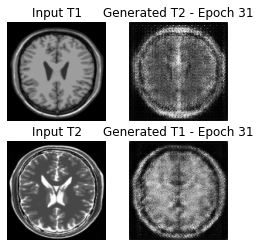

Saving checkpoint for epoch 31 at ./training_checkpoints/ckpt-31


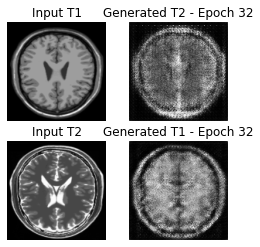

Saving checkpoint for epoch 32 at ./training_checkpoints/ckpt-32


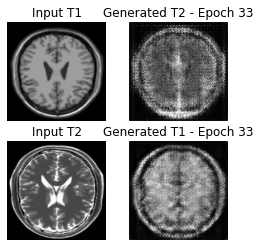

Saving checkpoint for epoch 33 at ./training_checkpoints/ckpt-33


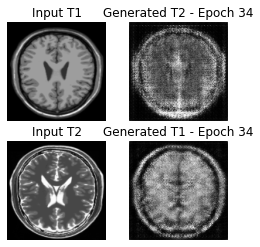

Saving checkpoint for epoch 34 at ./training_checkpoints/ckpt-34


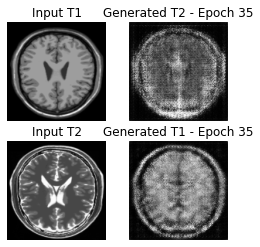

Saving checkpoint for epoch 35 at ./training_checkpoints/ckpt-35


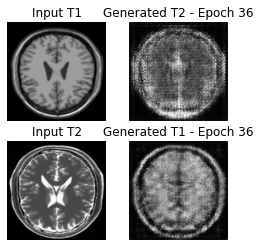

Saving checkpoint for epoch 36 at ./training_checkpoints/ckpt-36


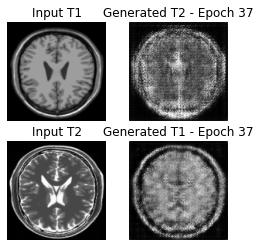

Saving checkpoint for epoch 37 at ./training_checkpoints/ckpt-37


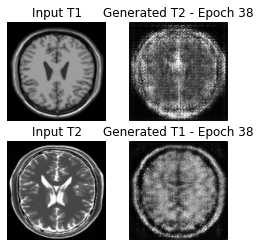

Saving checkpoint for epoch 38 at ./training_checkpoints/ckpt-38


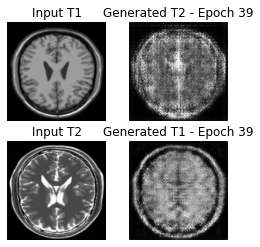

Saving checkpoint for epoch 39 at ./training_checkpoints/ckpt-39


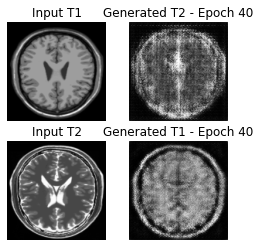

Saving checkpoint for epoch 40 at ./training_checkpoints/ckpt-40


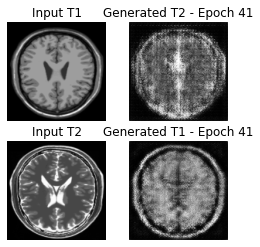

Saving checkpoint for epoch 41 at ./training_checkpoints/ckpt-41


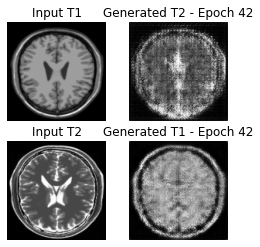

Saving checkpoint for epoch 42 at ./training_checkpoints/ckpt-42


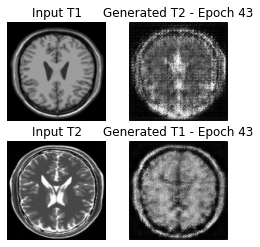

Saving checkpoint for epoch 43 at ./training_checkpoints/ckpt-43


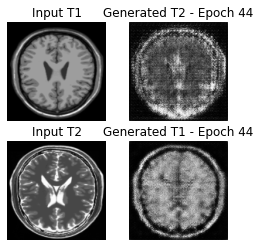

Saving checkpoint for epoch 44 at ./training_checkpoints/ckpt-44


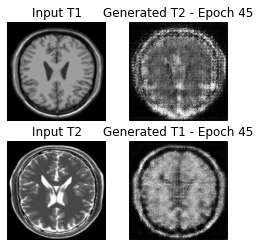

Saving checkpoint for epoch 45 at ./training_checkpoints/ckpt-45


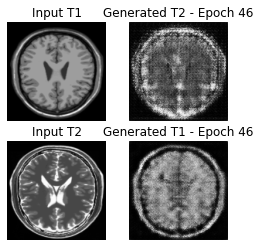

Saving checkpoint for epoch 46 at ./training_checkpoints/ckpt-46


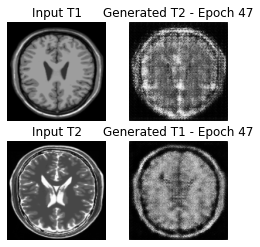

Saving checkpoint for epoch 47 at ./training_checkpoints/ckpt-47


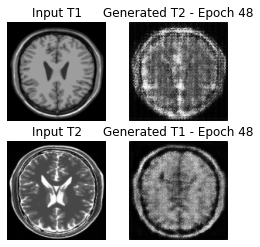

Saving checkpoint for epoch 48 at ./training_checkpoints/ckpt-48


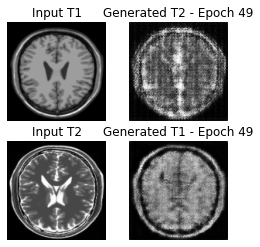

Saving checkpoint for epoch 49 at ./training_checkpoints/ckpt-49


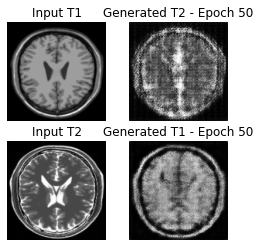

Saving checkpoint for epoch 50 at ./training_checkpoints/ckpt-50


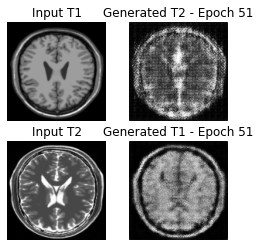

Saving checkpoint for epoch 51 at ./training_checkpoints/ckpt-51


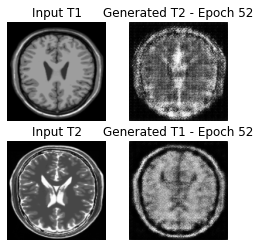

Saving checkpoint for epoch 52 at ./training_checkpoints/ckpt-52


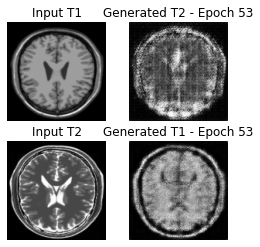

Saving checkpoint for epoch 53 at ./training_checkpoints/ckpt-53


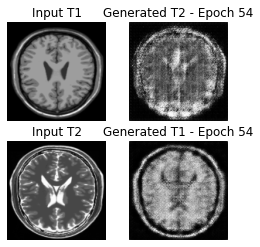

Saving checkpoint for epoch 54 at ./training_checkpoints/ckpt-54


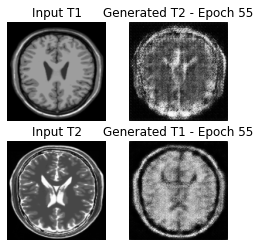

Saving checkpoint for epoch 55 at ./training_checkpoints/ckpt-55


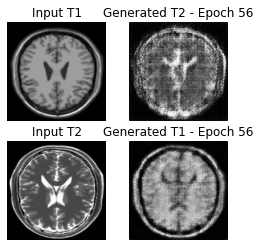

Saving checkpoint for epoch 56 at ./training_checkpoints/ckpt-56


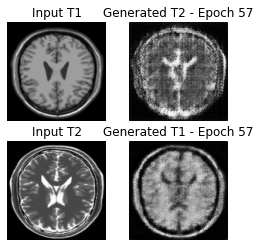

Saving checkpoint for epoch 57 at ./training_checkpoints/ckpt-57


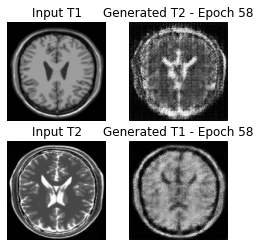

Saving checkpoint for epoch 58 at ./training_checkpoints/ckpt-58


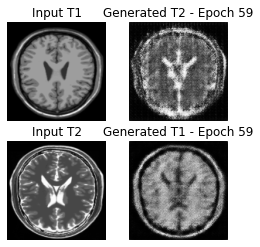

Saving checkpoint for epoch 59 at ./training_checkpoints/ckpt-59


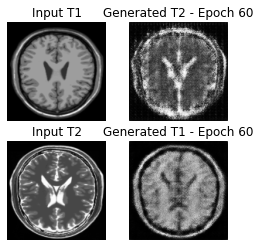

Saving checkpoint for epoch 60 at ./training_checkpoints/ckpt-60


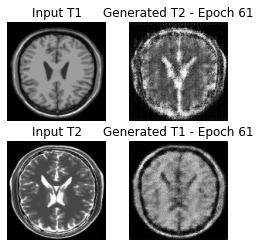

Saving checkpoint for epoch 61 at ./training_checkpoints/ckpt-61


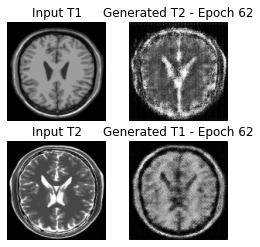

Saving checkpoint for epoch 62 at ./training_checkpoints/ckpt-62


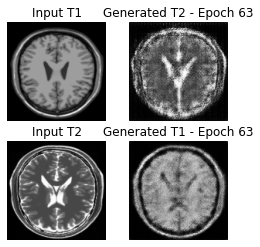

Saving checkpoint for epoch 63 at ./training_checkpoints/ckpt-63


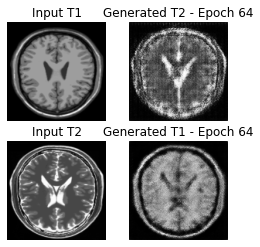

Saving checkpoint for epoch 64 at ./training_checkpoints/ckpt-64


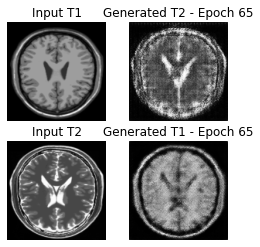

Saving checkpoint for epoch 65 at ./training_checkpoints/ckpt-65


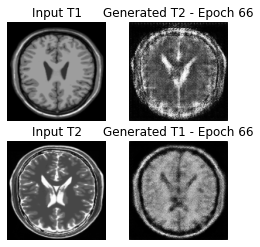

Saving checkpoint for epoch 66 at ./training_checkpoints/ckpt-66


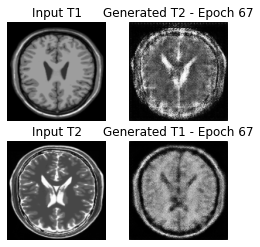

Saving checkpoint for epoch 67 at ./training_checkpoints/ckpt-67


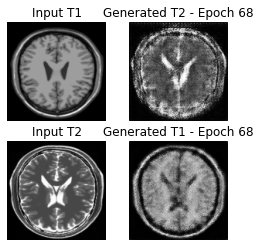

Saving checkpoint for epoch 68 at ./training_checkpoints/ckpt-68


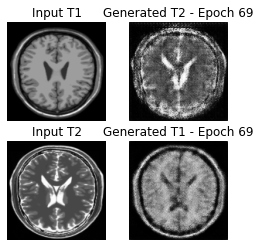

Saving checkpoint for epoch 69 at ./training_checkpoints/ckpt-69


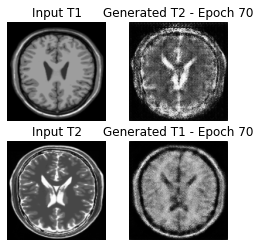

Saving checkpoint for epoch 70 at ./training_checkpoints/ckpt-70


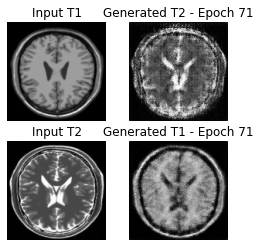

Saving checkpoint for epoch 71 at ./training_checkpoints/ckpt-71


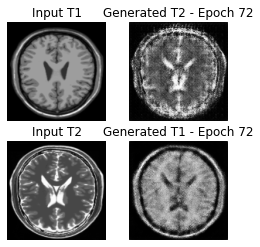

Saving checkpoint for epoch 72 at ./training_checkpoints/ckpt-72


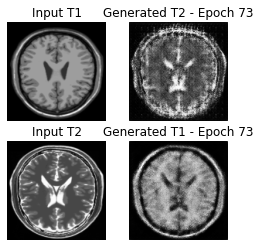

Saving checkpoint for epoch 73 at ./training_checkpoints/ckpt-73


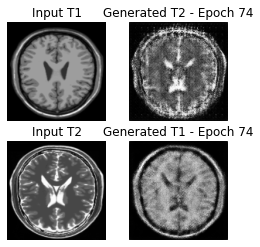

Saving checkpoint for epoch 74 at ./training_checkpoints/ckpt-74


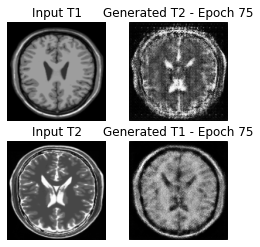

Saving checkpoint for epoch 75 at ./training_checkpoints/ckpt-75


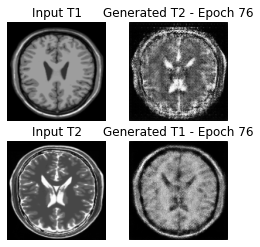

Saving checkpoint for epoch 76 at ./training_checkpoints/ckpt-76


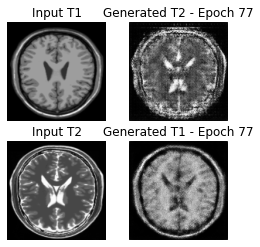

Saving checkpoint for epoch 77 at ./training_checkpoints/ckpt-77


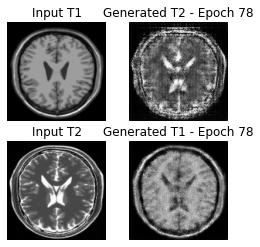

Saving checkpoint for epoch 78 at ./training_checkpoints/ckpt-78


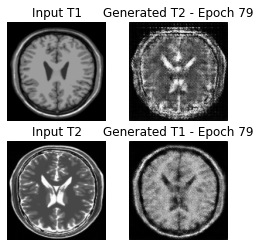

Saving checkpoint for epoch 79 at ./training_checkpoints/ckpt-79


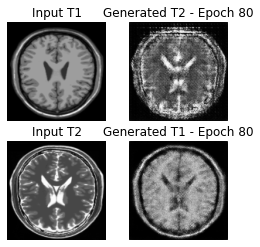

Saving checkpoint for epoch 80 at ./training_checkpoints/ckpt-80


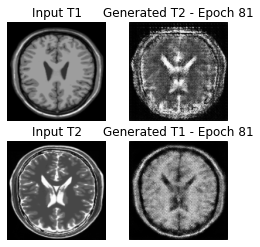

Saving checkpoint for epoch 81 at ./training_checkpoints/ckpt-81


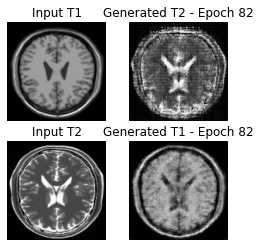

Saving checkpoint for epoch 82 at ./training_checkpoints/ckpt-82


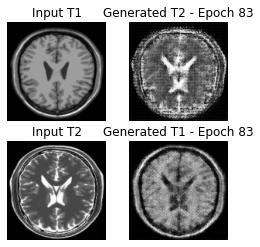

Saving checkpoint for epoch 83 at ./training_checkpoints/ckpt-83


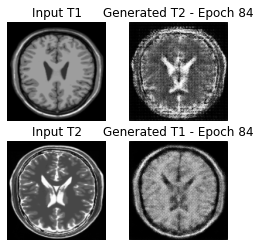

Saving checkpoint for epoch 84 at ./training_checkpoints/ckpt-84


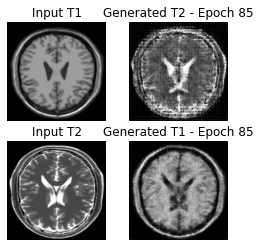

Saving checkpoint for epoch 85 at ./training_checkpoints/ckpt-85


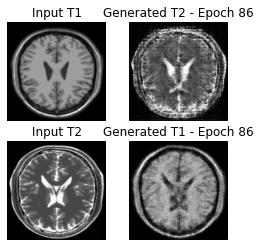

Saving checkpoint for epoch 86 at ./training_checkpoints/ckpt-86


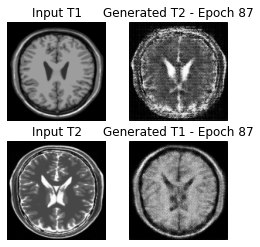

Saving checkpoint for epoch 87 at ./training_checkpoints/ckpt-87


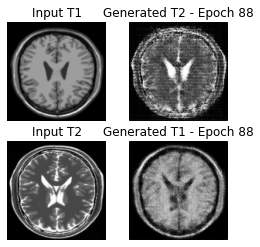

Saving checkpoint for epoch 88 at ./training_checkpoints/ckpt-88


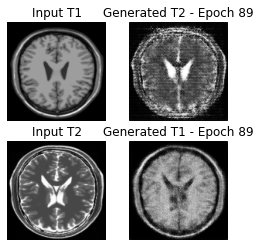

Saving checkpoint for epoch 89 at ./training_checkpoints/ckpt-89


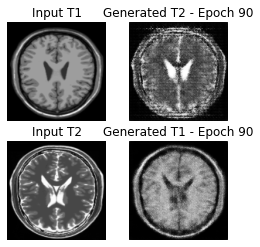

Saving checkpoint for epoch 90 at ./training_checkpoints/ckpt-90


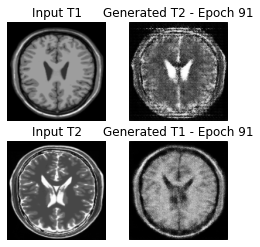

Saving checkpoint for epoch 91 at ./training_checkpoints/ckpt-91


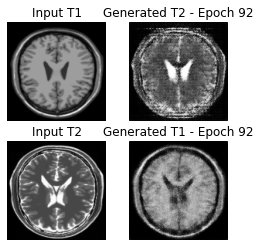

Saving checkpoint for epoch 92 at ./training_checkpoints/ckpt-92


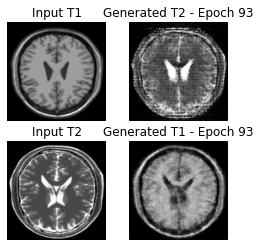

Saving checkpoint for epoch 93 at ./training_checkpoints/ckpt-93


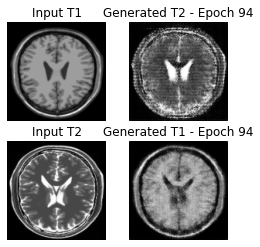

Saving checkpoint for epoch 94 at ./training_checkpoints/ckpt-94


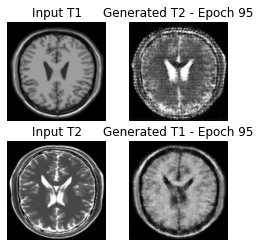

Saving checkpoint for epoch 95 at ./training_checkpoints/ckpt-95


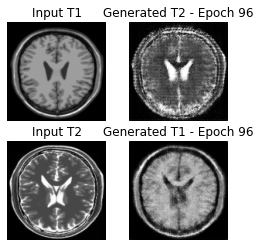

Saving checkpoint for epoch 96 at ./training_checkpoints/ckpt-96


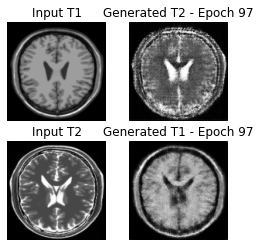

Saving checkpoint for epoch 97 at ./training_checkpoints/ckpt-97


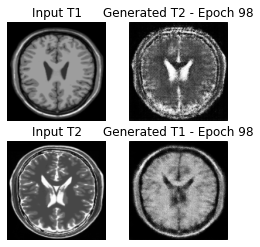

Saving checkpoint for epoch 98 at ./training_checkpoints/ckpt-98


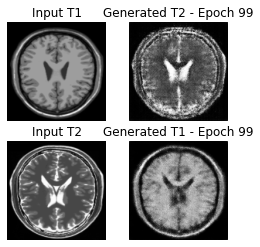

Saving checkpoint for epoch 99 at ./training_checkpoints/ckpt-99


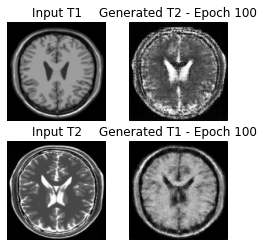

Saving checkpoint for epoch 100 at ./training_checkpoints/ckpt-100


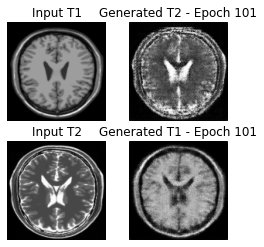

Saving checkpoint for epoch 101 at ./training_checkpoints/ckpt-101


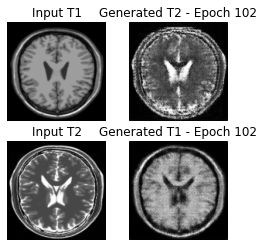

Saving checkpoint for epoch 102 at ./training_checkpoints/ckpt-102


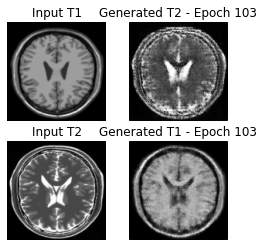

Saving checkpoint for epoch 103 at ./training_checkpoints/ckpt-103


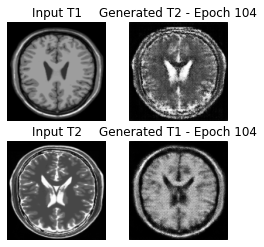

Saving checkpoint for epoch 104 at ./training_checkpoints/ckpt-104


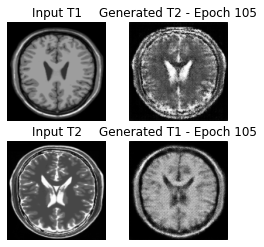

Saving checkpoint for epoch 105 at ./training_checkpoints/ckpt-105


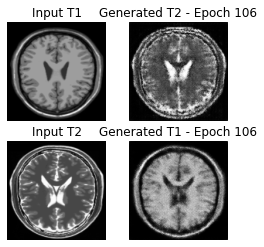

Saving checkpoint for epoch 106 at ./training_checkpoints/ckpt-106


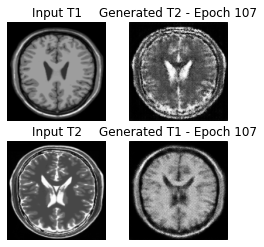

Saving checkpoint for epoch 107 at ./training_checkpoints/ckpt-107


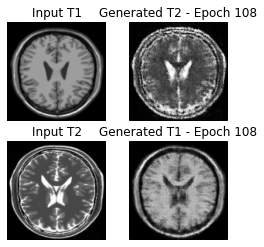

Saving checkpoint for epoch 108 at ./training_checkpoints/ckpt-108


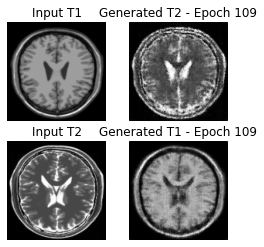

Saving checkpoint for epoch 109 at ./training_checkpoints/ckpt-109


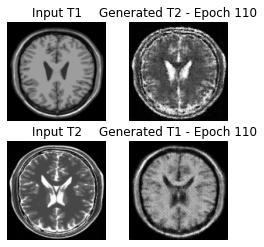

Saving checkpoint for epoch 110 at ./training_checkpoints/ckpt-110


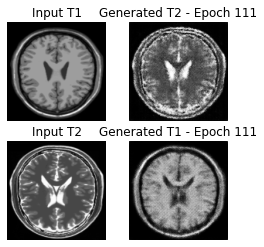

Saving checkpoint for epoch 111 at ./training_checkpoints/ckpt-111


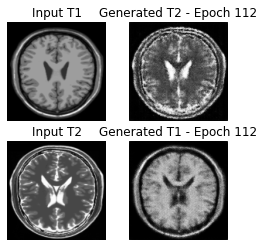

Saving checkpoint for epoch 112 at ./training_checkpoints/ckpt-112


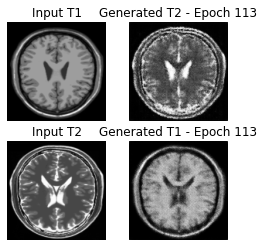

Saving checkpoint for epoch 113 at ./training_checkpoints/ckpt-113


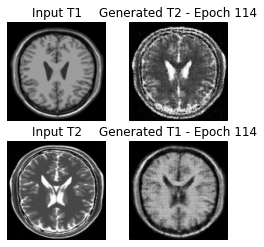

Saving checkpoint for epoch 114 at ./training_checkpoints/ckpt-114


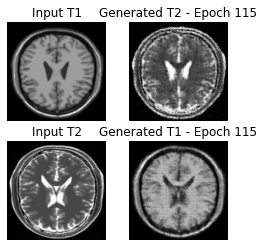

Saving checkpoint for epoch 115 at ./training_checkpoints/ckpt-115


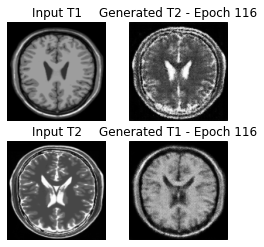

Saving checkpoint for epoch 116 at ./training_checkpoints/ckpt-116


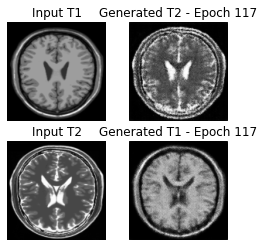

Saving checkpoint for epoch 117 at ./training_checkpoints/ckpt-117


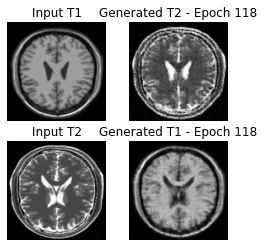

Saving checkpoint for epoch 118 at ./training_checkpoints/ckpt-118


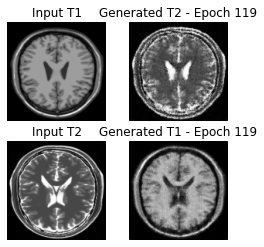

Saving checkpoint for epoch 119 at ./training_checkpoints/ckpt-119


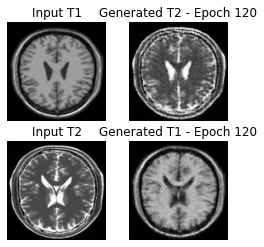

Saving checkpoint for epoch 120 at ./training_checkpoints/ckpt-120


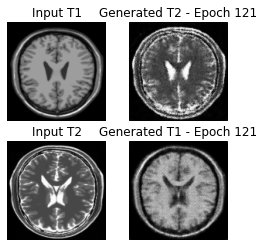

Saving checkpoint for epoch 121 at ./training_checkpoints/ckpt-121


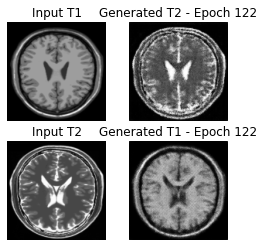

Saving checkpoint for epoch 122 at ./training_checkpoints/ckpt-122


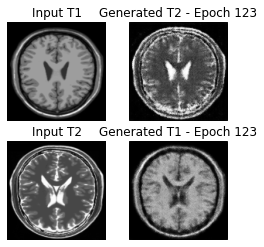

Saving checkpoint for epoch 123 at ./training_checkpoints/ckpt-123


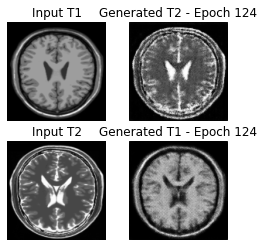

Saving checkpoint for epoch 124 at ./training_checkpoints/ckpt-124


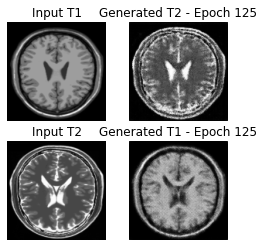

Saving checkpoint for epoch 125 at ./training_checkpoints/ckpt-125


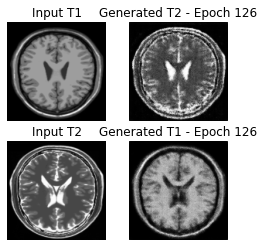

Saving checkpoint for epoch 126 at ./training_checkpoints/ckpt-126


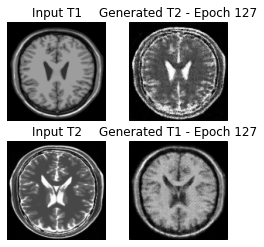

Saving checkpoint for epoch 127 at ./training_checkpoints/ckpt-127


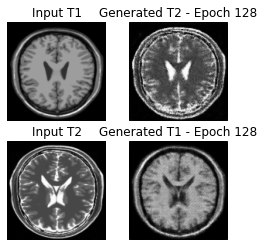

Saving checkpoint for epoch 128 at ./training_checkpoints/ckpt-128


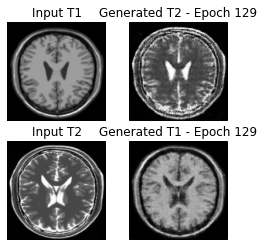

Saving checkpoint for epoch 129 at ./training_checkpoints/ckpt-129


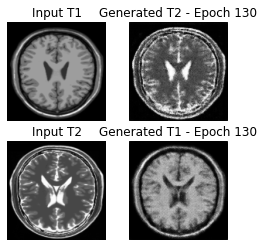

Saving checkpoint for epoch 130 at ./training_checkpoints/ckpt-130


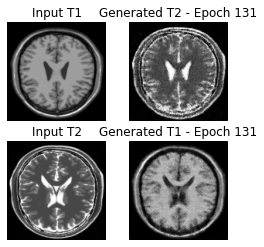

Saving checkpoint for epoch 131 at ./training_checkpoints/ckpt-131


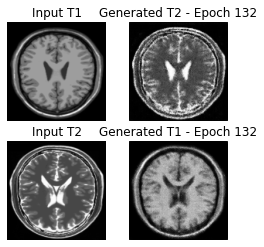

Saving checkpoint for epoch 132 at ./training_checkpoints/ckpt-132


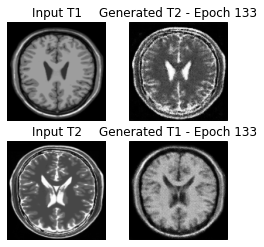

Saving checkpoint for epoch 133 at ./training_checkpoints/ckpt-133


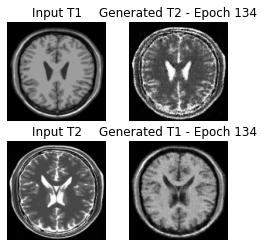

Saving checkpoint for epoch 134 at ./training_checkpoints/ckpt-134


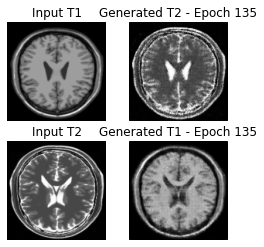

Saving checkpoint for epoch 135 at ./training_checkpoints/ckpt-135


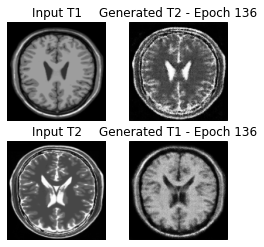

Saving checkpoint for epoch 136 at ./training_checkpoints/ckpt-136


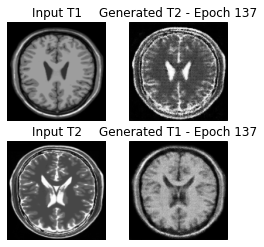

Saving checkpoint for epoch 137 at ./training_checkpoints/ckpt-137


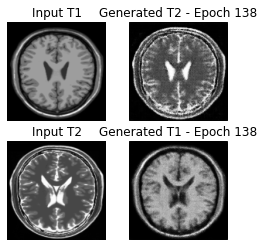

Saving checkpoint for epoch 138 at ./training_checkpoints/ckpt-138


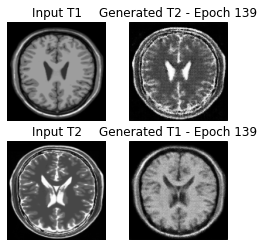

Saving checkpoint for epoch 139 at ./training_checkpoints/ckpt-139


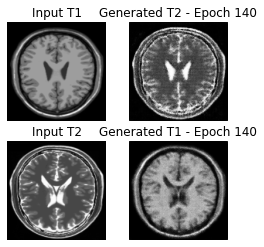

Saving checkpoint for epoch 140 at ./training_checkpoints/ckpt-140


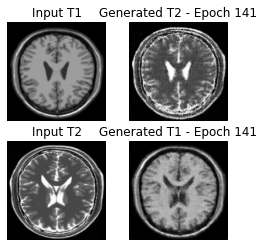

Saving checkpoint for epoch 141 at ./training_checkpoints/ckpt-141


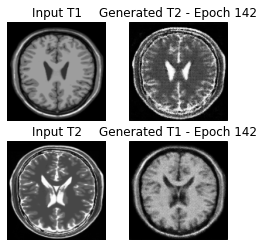

Saving checkpoint for epoch 142 at ./training_checkpoints/ckpt-142


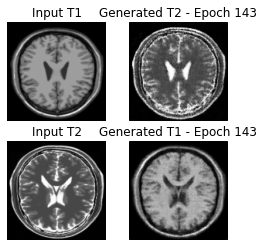

Saving checkpoint for epoch 143 at ./training_checkpoints/ckpt-143


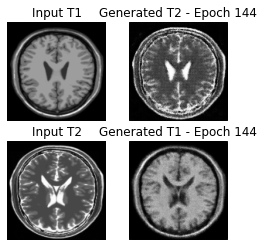

Saving checkpoint for epoch 144 at ./training_checkpoints/ckpt-144


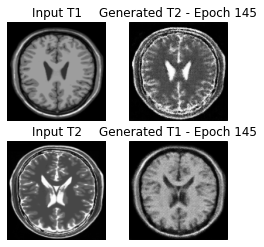

Saving checkpoint for epoch 145 at ./training_checkpoints/ckpt-145


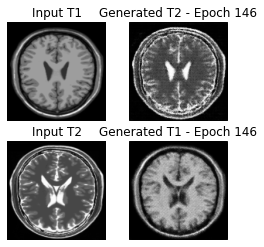

Saving checkpoint for epoch 146 at ./training_checkpoints/ckpt-146


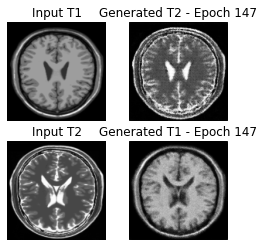

Saving checkpoint for epoch 147 at ./training_checkpoints/ckpt-147


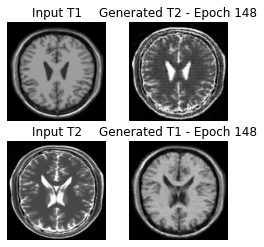

Saving checkpoint for epoch 148 at ./training_checkpoints/ckpt-148


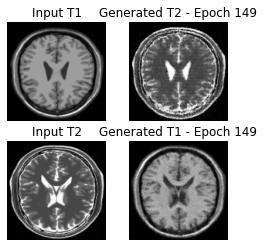

Saving checkpoint for epoch 149 at ./training_checkpoints/ckpt-149


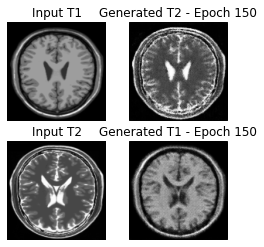

Saving checkpoint for epoch 150 at ./training_checkpoints/ckpt-150


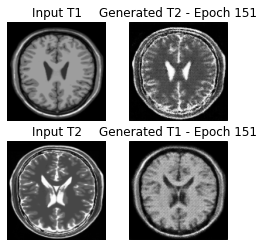

Saving checkpoint for epoch 151 at ./training_checkpoints/ckpt-151


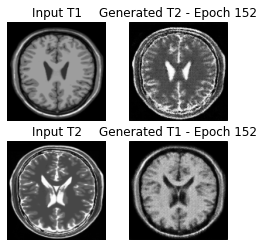

Saving checkpoint for epoch 152 at ./training_checkpoints/ckpt-152


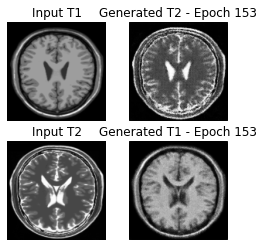

Saving checkpoint for epoch 153 at ./training_checkpoints/ckpt-153


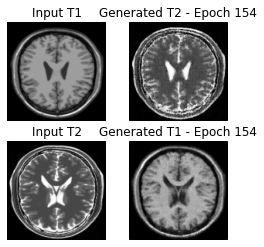

Saving checkpoint for epoch 154 at ./training_checkpoints/ckpt-154


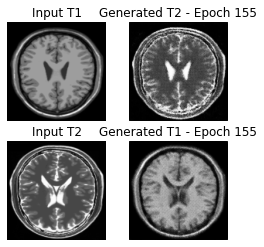

Saving checkpoint for epoch 155 at ./training_checkpoints/ckpt-155


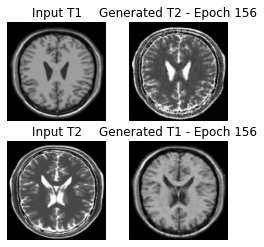

Saving checkpoint for epoch 156 at ./training_checkpoints/ckpt-156


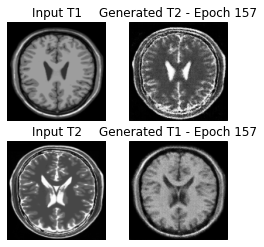

Saving checkpoint for epoch 157 at ./training_checkpoints/ckpt-157


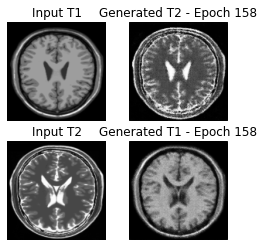

Saving checkpoint for epoch 158 at ./training_checkpoints/ckpt-158


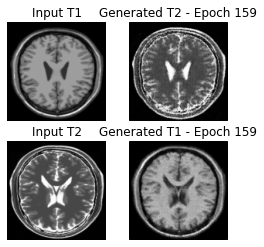

Saving checkpoint for epoch 159 at ./training_checkpoints/ckpt-159


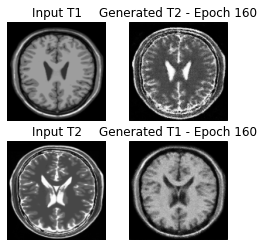

Saving checkpoint for epoch 160 at ./training_checkpoints/ckpt-160


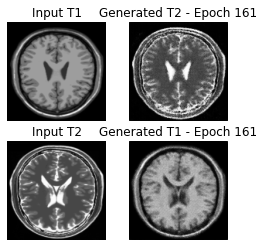

Saving checkpoint for epoch 161 at ./training_checkpoints/ckpt-161


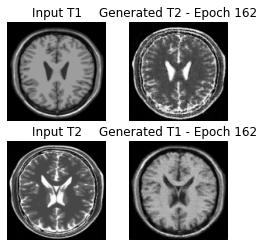

Saving checkpoint for epoch 162 at ./training_checkpoints/ckpt-162


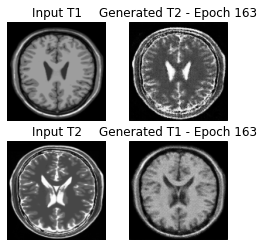

Saving checkpoint for epoch 163 at ./training_checkpoints/ckpt-163


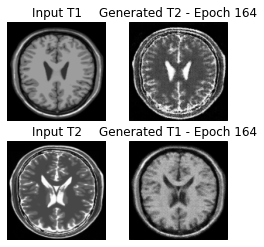

Saving checkpoint for epoch 164 at ./training_checkpoints/ckpt-164


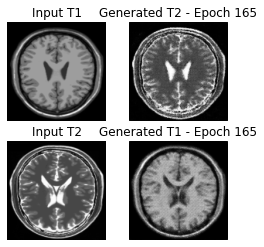

Saving checkpoint for epoch 165 at ./training_checkpoints/ckpt-165


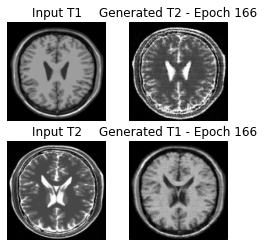

Saving checkpoint for epoch 166 at ./training_checkpoints/ckpt-166


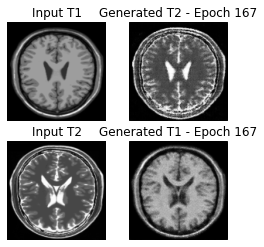

Saving checkpoint for epoch 167 at ./training_checkpoints/ckpt-167


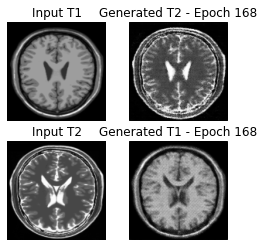

Saving checkpoint for epoch 168 at ./training_checkpoints/ckpt-168


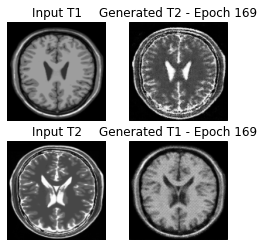

Saving checkpoint for epoch 169 at ./training_checkpoints/ckpt-169


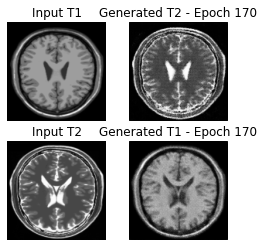

Saving checkpoint for epoch 170 at ./training_checkpoints/ckpt-170


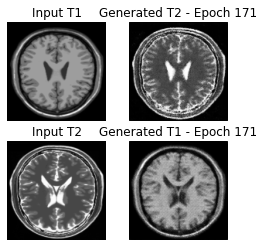

Saving checkpoint for epoch 171 at ./training_checkpoints/ckpt-171


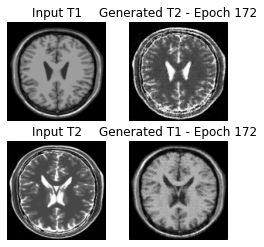

Saving checkpoint for epoch 172 at ./training_checkpoints/ckpt-172


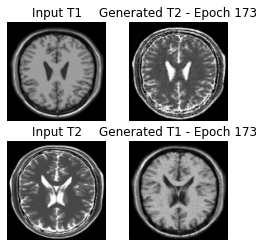

Saving checkpoint for epoch 173 at ./training_checkpoints/ckpt-173


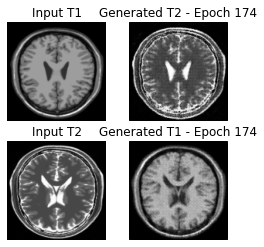

Saving checkpoint for epoch 174 at ./training_checkpoints/ckpt-174


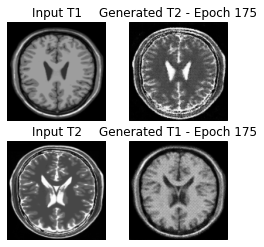

Saving checkpoint for epoch 175 at ./training_checkpoints/ckpt-175


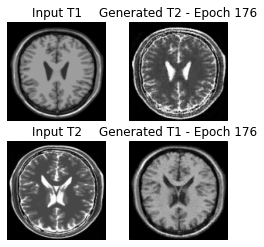

Saving checkpoint for epoch 176 at ./training_checkpoints/ckpt-176


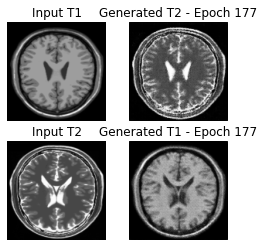

Saving checkpoint for epoch 177 at ./training_checkpoints/ckpt-177


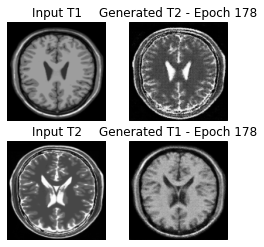

Saving checkpoint for epoch 178 at ./training_checkpoints/ckpt-178


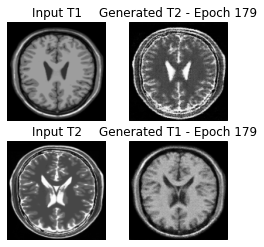

Saving checkpoint for epoch 179 at ./training_checkpoints/ckpt-179


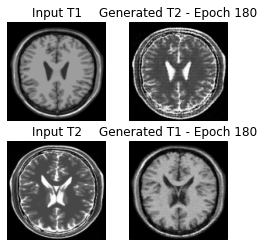

Saving checkpoint for epoch 180 at ./training_checkpoints/ckpt-180


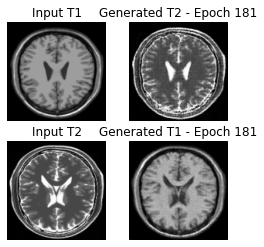

Saving checkpoint for epoch 181 at ./training_checkpoints/ckpt-181


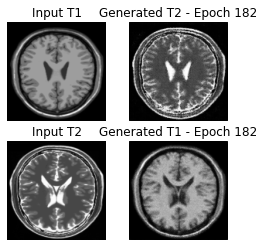

Saving checkpoint for epoch 182 at ./training_checkpoints/ckpt-182


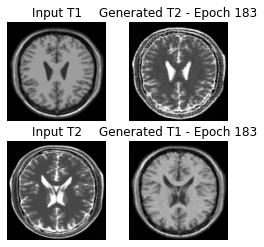

Saving checkpoint for epoch 183 at ./training_checkpoints/ckpt-183


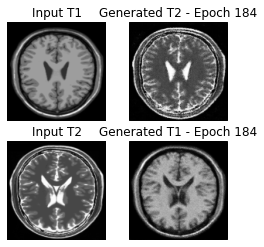

Saving checkpoint for epoch 184 at ./training_checkpoints/ckpt-184


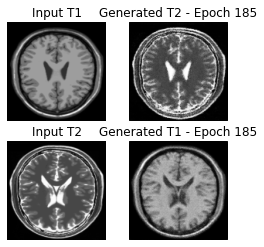

Saving checkpoint for epoch 185 at ./training_checkpoints/ckpt-185


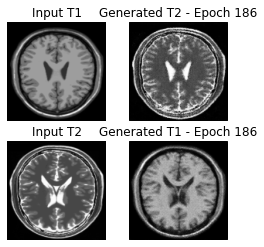

Saving checkpoint for epoch 186 at ./training_checkpoints/ckpt-186


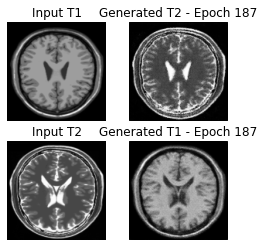

Saving checkpoint for epoch 187 at ./training_checkpoints/ckpt-187


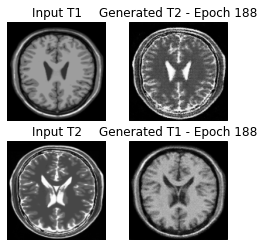

Saving checkpoint for epoch 188 at ./training_checkpoints/ckpt-188


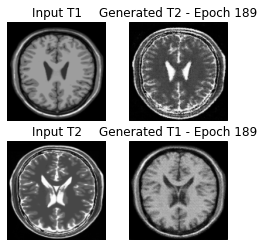

Saving checkpoint for epoch 189 at ./training_checkpoints/ckpt-189


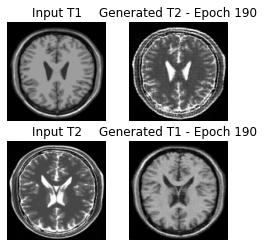

Saving checkpoint for epoch 190 at ./training_checkpoints/ckpt-190


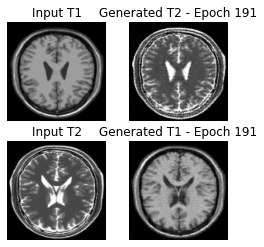

Saving checkpoint for epoch 191 at ./training_checkpoints/ckpt-191


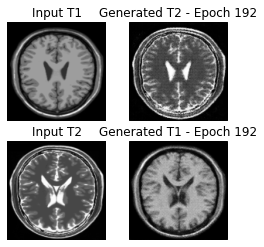

Saving checkpoint for epoch 192 at ./training_checkpoints/ckpt-192


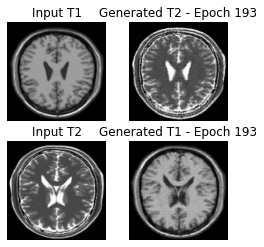

Saving checkpoint for epoch 193 at ./training_checkpoints/ckpt-193


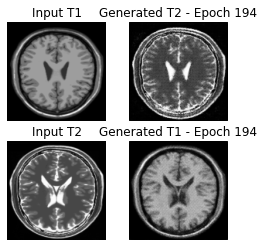

Saving checkpoint for epoch 194 at ./training_checkpoints/ckpt-194


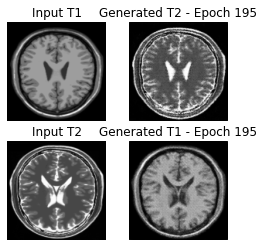

Saving checkpoint for epoch 195 at ./training_checkpoints/ckpt-195


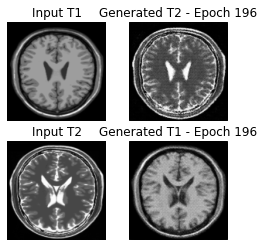

Saving checkpoint for epoch 196 at ./training_checkpoints/ckpt-196


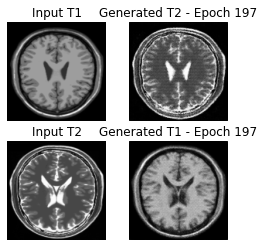

Saving checkpoint for epoch 197 at ./training_checkpoints/ckpt-197


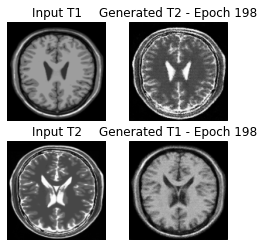

Saving checkpoint for epoch 198 at ./training_checkpoints/ckpt-198


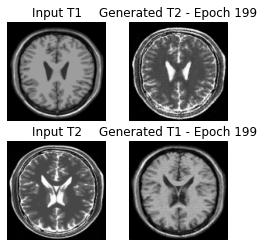

Saving checkpoint for epoch 199 at ./training_checkpoints/ckpt-199


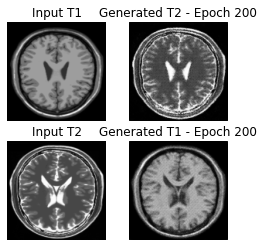

Saving checkpoint for epoch 200 at ./training_checkpoints/ckpt-200


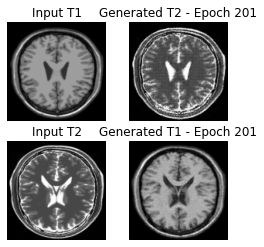

Saving checkpoint for epoch 201 at ./training_checkpoints/ckpt-201
Saving checkpoint for epoch 202 at ./training_checkpoints/ckpt-202


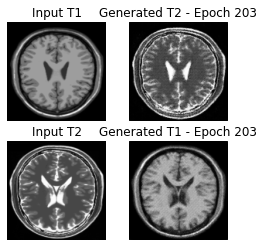

Saving checkpoint for epoch 203 at ./training_checkpoints/ckpt-203


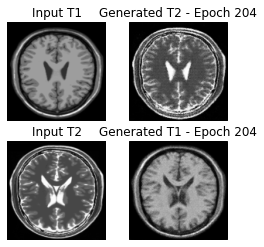

Saving checkpoint for epoch 204 at ./training_checkpoints/ckpt-204


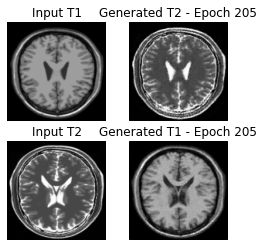

Saving checkpoint for epoch 205 at ./training_checkpoints/ckpt-205


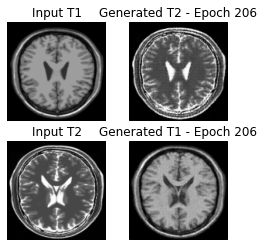

Saving checkpoint for epoch 206 at ./training_checkpoints/ckpt-206


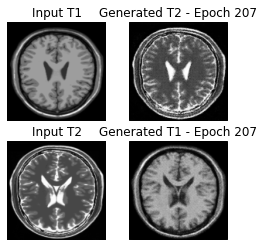

Saving checkpoint for epoch 207 at ./training_checkpoints/ckpt-207


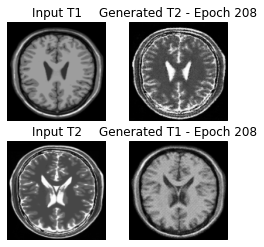

Saving checkpoint for epoch 208 at ./training_checkpoints/ckpt-208


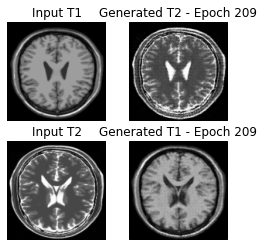

Saving checkpoint for epoch 209 at ./training_checkpoints/ckpt-209


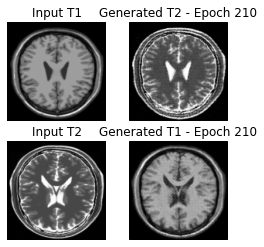

Saving checkpoint for epoch 210 at ./training_checkpoints/ckpt-210


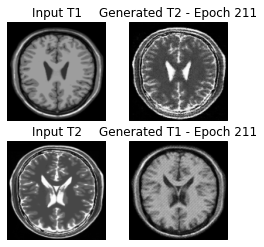

Saving checkpoint for epoch 211 at ./training_checkpoints/ckpt-211


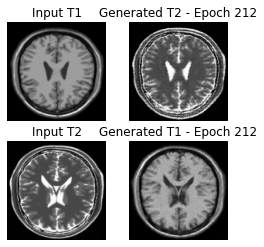

Saving checkpoint for epoch 212 at ./training_checkpoints/ckpt-212


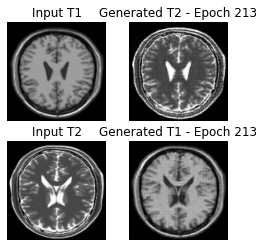

Saving checkpoint for epoch 213 at ./training_checkpoints/ckpt-213


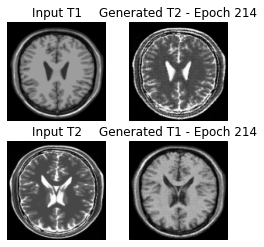

Saving checkpoint for epoch 214 at ./training_checkpoints/ckpt-214


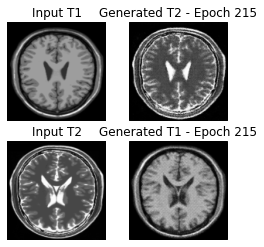

Saving checkpoint for epoch 215 at ./training_checkpoints/ckpt-215


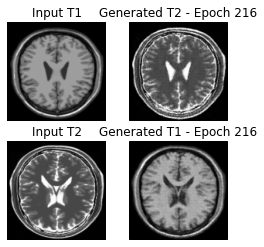

Saving checkpoint for epoch 216 at ./training_checkpoints/ckpt-216


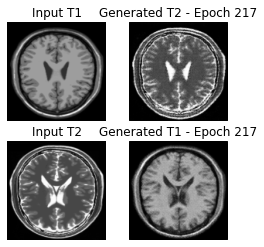

Saving checkpoint for epoch 217 at ./training_checkpoints/ckpt-217


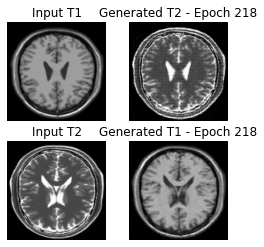

Saving checkpoint for epoch 218 at ./training_checkpoints/ckpt-218


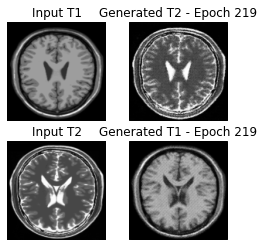

Saving checkpoint for epoch 219 at ./training_checkpoints/ckpt-219


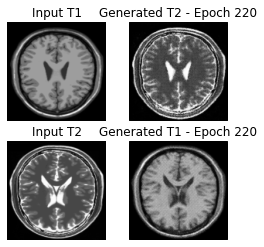

Saving checkpoint for epoch 220 at ./training_checkpoints/ckpt-220


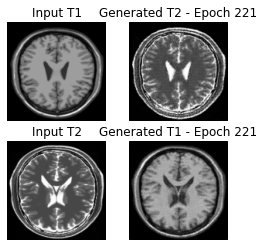

Saving checkpoint for epoch 221 at ./training_checkpoints/ckpt-221


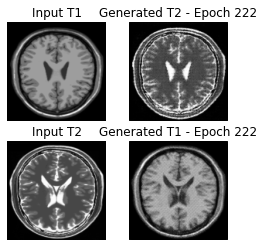

Saving checkpoint for epoch 222 at ./training_checkpoints/ckpt-222


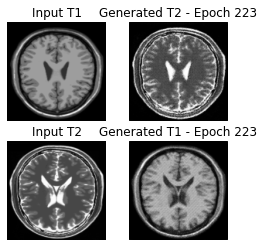

Saving checkpoint for epoch 223 at ./training_checkpoints/ckpt-223


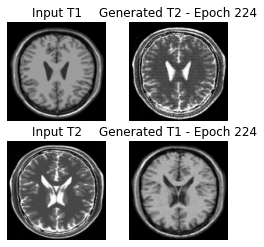

Saving checkpoint for epoch 224 at ./training_checkpoints/ckpt-224


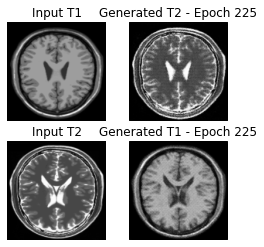

Saving checkpoint for epoch 225 at ./training_checkpoints/ckpt-225


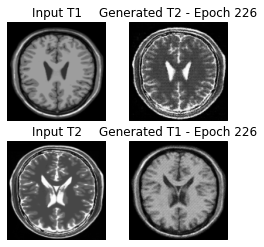

Saving checkpoint for epoch 226 at ./training_checkpoints/ckpt-226


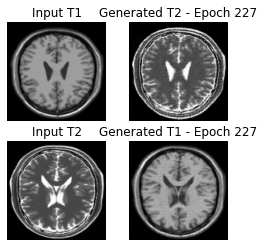

Saving checkpoint for epoch 227 at ./training_checkpoints/ckpt-227


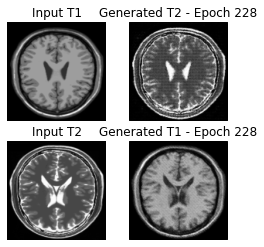

Saving checkpoint for epoch 228 at ./training_checkpoints/ckpt-228


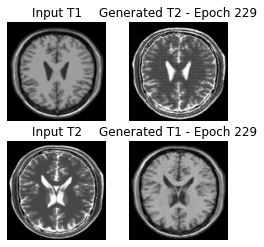

Saving checkpoint for epoch 229 at ./training_checkpoints/ckpt-229


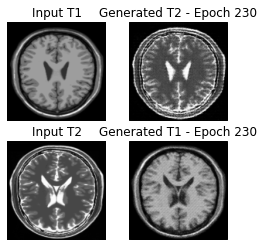

Saving checkpoint for epoch 230 at ./training_checkpoints/ckpt-230


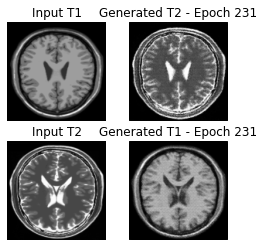

Saving checkpoint for epoch 231 at ./training_checkpoints/ckpt-231


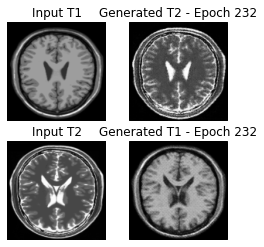

Saving checkpoint for epoch 232 at ./training_checkpoints/ckpt-232


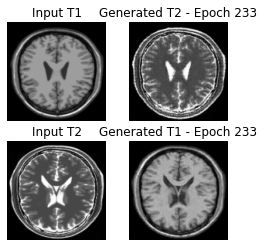

Saving checkpoint for epoch 233 at ./training_checkpoints/ckpt-233


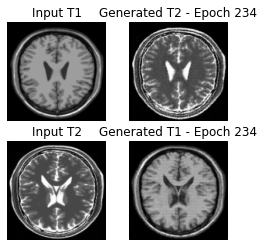

Saving checkpoint for epoch 234 at ./training_checkpoints/ckpt-234


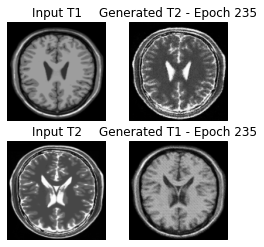

Saving checkpoint for epoch 235 at ./training_checkpoints/ckpt-235


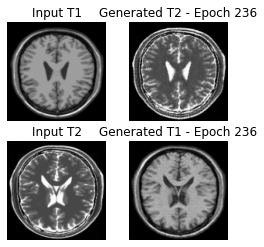

Saving checkpoint for epoch 236 at ./training_checkpoints/ckpt-236


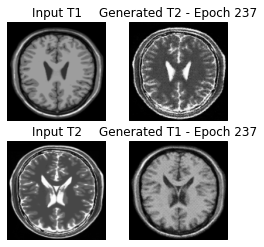

Saving checkpoint for epoch 237 at ./training_checkpoints/ckpt-237


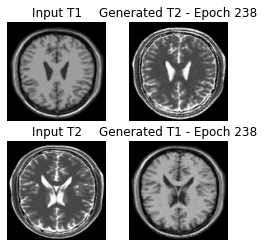

Saving checkpoint for epoch 238 at ./training_checkpoints/ckpt-238


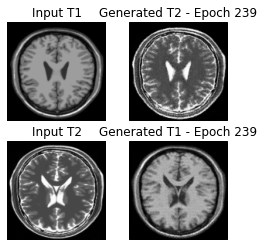

Saving checkpoint for epoch 239 at ./training_checkpoints/ckpt-239


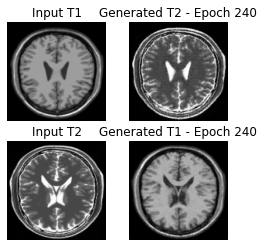

Saving checkpoint for epoch 240 at ./training_checkpoints/ckpt-240


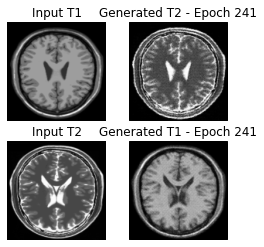

Saving checkpoint for epoch 241 at ./training_checkpoints/ckpt-241


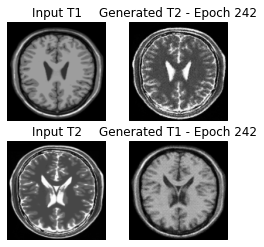

Saving checkpoint for epoch 242 at ./training_checkpoints/ckpt-242


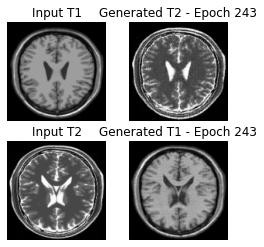

Saving checkpoint for epoch 243 at ./training_checkpoints/ckpt-243


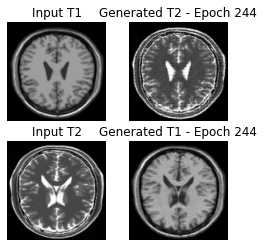

Saving checkpoint for epoch 244 at ./training_checkpoints/ckpt-244


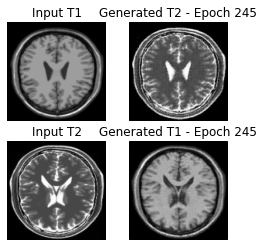

Saving checkpoint for epoch 245 at ./training_checkpoints/ckpt-245


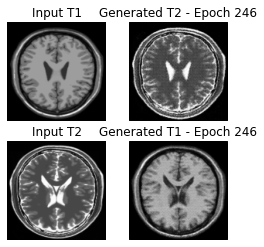

Saving checkpoint for epoch 246 at ./training_checkpoints/ckpt-246


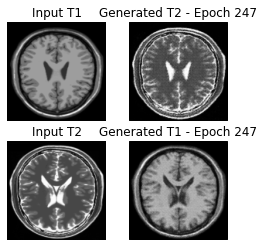

Saving checkpoint for epoch 247 at ./training_checkpoints/ckpt-247


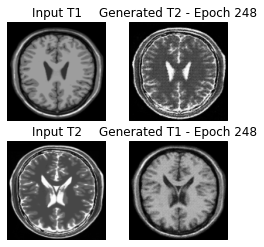

Saving checkpoint for epoch 248 at ./training_checkpoints/ckpt-248


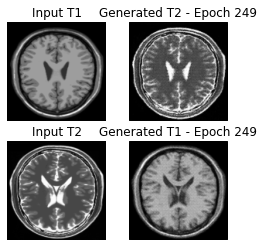

Saving checkpoint for epoch 249 at ./training_checkpoints/ckpt-249


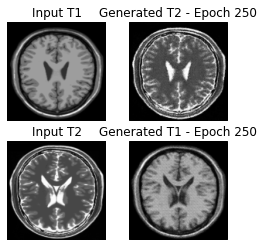

Saving checkpoint for epoch 250 at ./training_checkpoints/ckpt-250


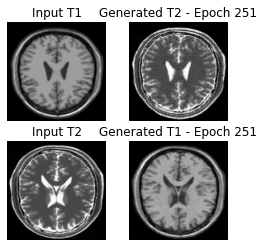

Saving checkpoint for epoch 251 at ./training_checkpoints/ckpt-251


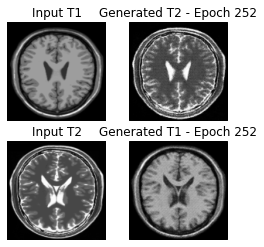

Saving checkpoint for epoch 252 at ./training_checkpoints/ckpt-252


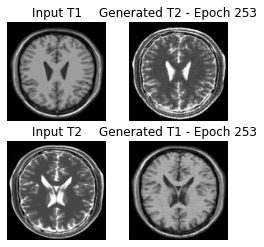

Saving checkpoint for epoch 253 at ./training_checkpoints/ckpt-253


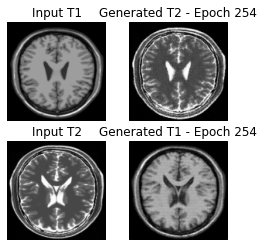

Saving checkpoint for epoch 254 at ./training_checkpoints/ckpt-254


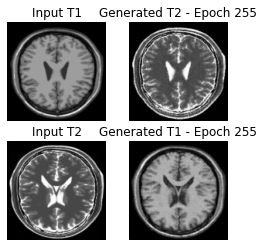

Saving checkpoint for epoch 255 at ./training_checkpoints/ckpt-255


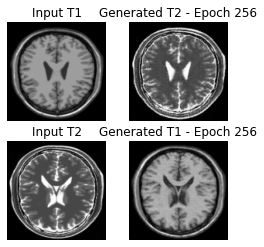

Saving checkpoint for epoch 256 at ./training_checkpoints/ckpt-256


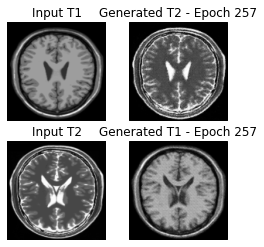

Saving checkpoint for epoch 257 at ./training_checkpoints/ckpt-257


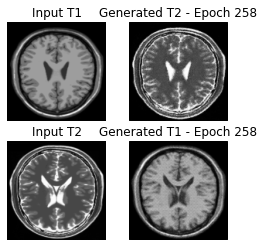

Saving checkpoint for epoch 258 at ./training_checkpoints/ckpt-258


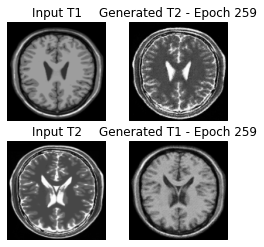

Saving checkpoint for epoch 259 at ./training_checkpoints/ckpt-259


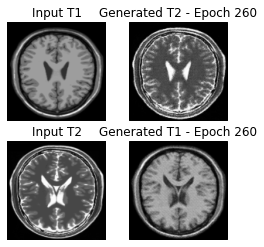

Saving checkpoint for epoch 260 at ./training_checkpoints/ckpt-260


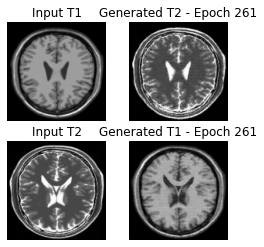

Saving checkpoint for epoch 261 at ./training_checkpoints/ckpt-261


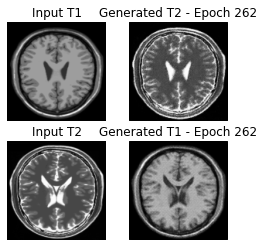

Saving checkpoint for epoch 262 at ./training_checkpoints/ckpt-262


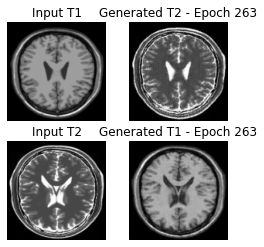

Saving checkpoint for epoch 263 at ./training_checkpoints/ckpt-263


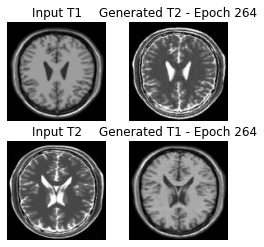

Saving checkpoint for epoch 264 at ./training_checkpoints/ckpt-264


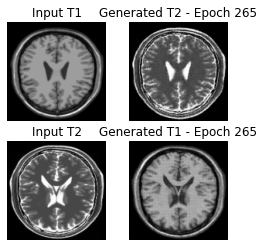

Saving checkpoint for epoch 265 at ./training_checkpoints/ckpt-265


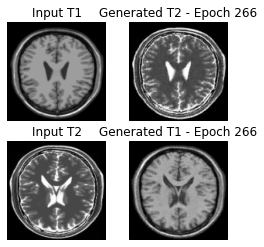

Saving checkpoint for epoch 266 at ./training_checkpoints/ckpt-266


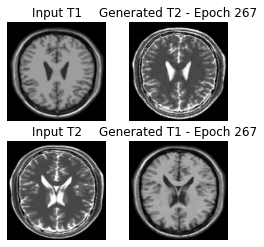

Saving checkpoint for epoch 267 at ./training_checkpoints/ckpt-267


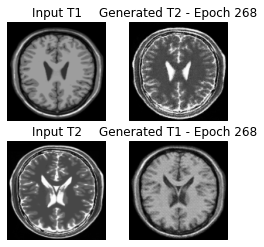

Saving checkpoint for epoch 268 at ./training_checkpoints/ckpt-268


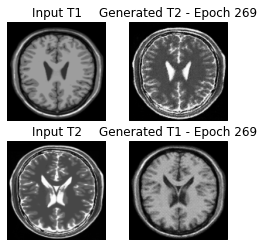

Saving checkpoint for epoch 269 at ./training_checkpoints/ckpt-269


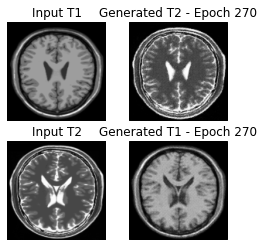

Saving checkpoint for epoch 270 at ./training_checkpoints/ckpt-270


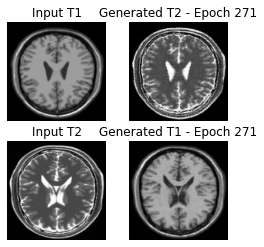

Saving checkpoint for epoch 271 at ./training_checkpoints/ckpt-271


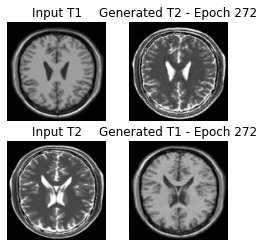

Saving checkpoint for epoch 272 at ./training_checkpoints/ckpt-272


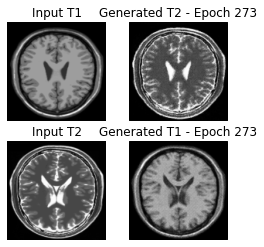

Saving checkpoint for epoch 273 at ./training_checkpoints/ckpt-273


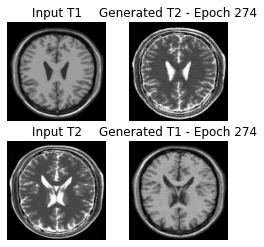

Saving checkpoint for epoch 274 at ./training_checkpoints/ckpt-274


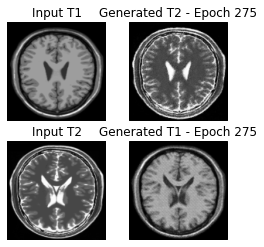

Saving checkpoint for epoch 275 at ./training_checkpoints/ckpt-275


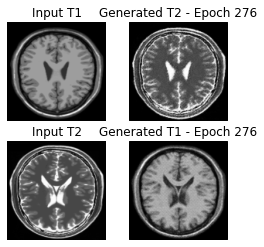

Saving checkpoint for epoch 276 at ./training_checkpoints/ckpt-276


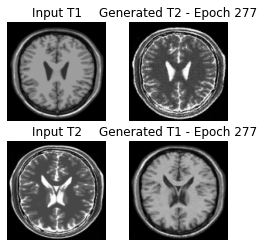

Saving checkpoint for epoch 277 at ./training_checkpoints/ckpt-277


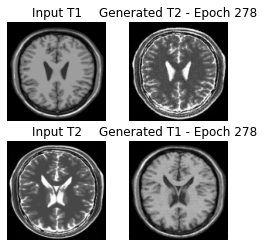

Saving checkpoint for epoch 278 at ./training_checkpoints/ckpt-278


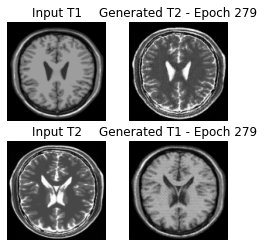

Saving checkpoint for epoch 279 at ./training_checkpoints/ckpt-279


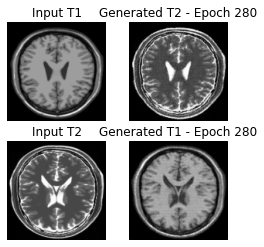

Saving checkpoint for epoch 280 at ./training_checkpoints/ckpt-280


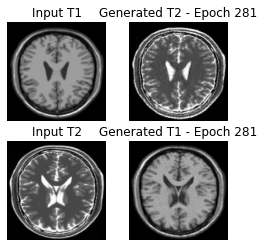

Saving checkpoint for epoch 281 at ./training_checkpoints/ckpt-281


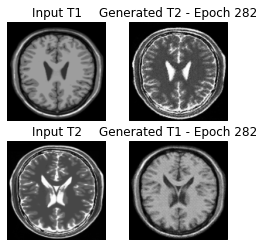

Saving checkpoint for epoch 282 at ./training_checkpoints/ckpt-282


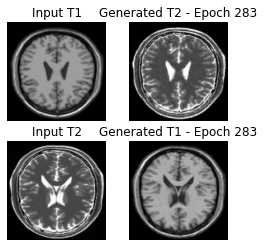

Saving checkpoint for epoch 283 at ./training_checkpoints/ckpt-283


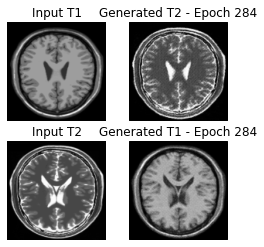

Saving checkpoint for epoch 284 at ./training_checkpoints/ckpt-284


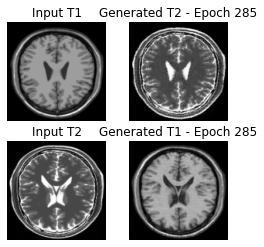

Saving checkpoint for epoch 285 at ./training_checkpoints/ckpt-285


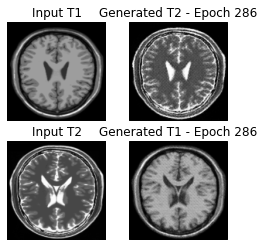

Saving checkpoint for epoch 286 at ./training_checkpoints/ckpt-286


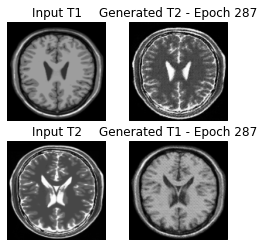

Saving checkpoint for epoch 287 at ./training_checkpoints/ckpt-287


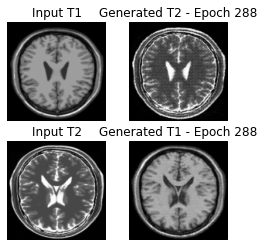

Saving checkpoint for epoch 288 at ./training_checkpoints/ckpt-288


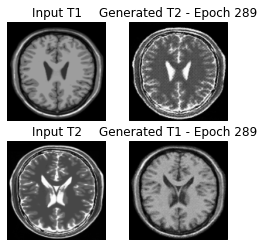

Saving checkpoint for epoch 289 at ./training_checkpoints/ckpt-289


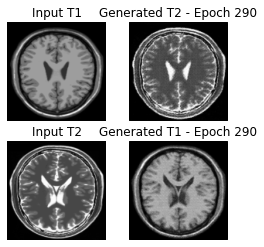

Saving checkpoint for epoch 290 at ./training_checkpoints/ckpt-290


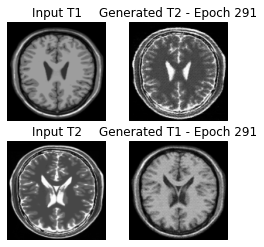

Saving checkpoint for epoch 291 at ./training_checkpoints/ckpt-291


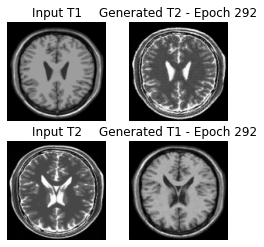

Saving checkpoint for epoch 292 at ./training_checkpoints/ckpt-292


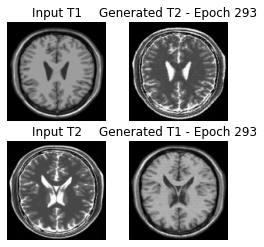

Saving checkpoint for epoch 293 at ./training_checkpoints/ckpt-293


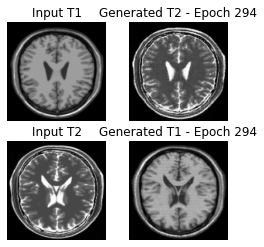

Saving checkpoint for epoch 294 at ./training_checkpoints/ckpt-294


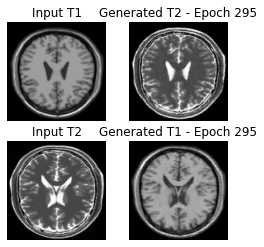

Saving checkpoint for epoch 295 at ./training_checkpoints/ckpt-295


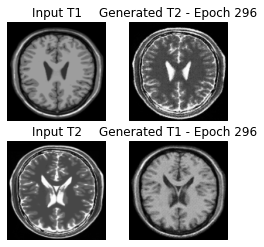

Saving checkpoint for epoch 296 at ./training_checkpoints/ckpt-296


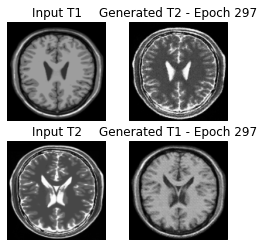

Saving checkpoint for epoch 297 at ./training_checkpoints/ckpt-297


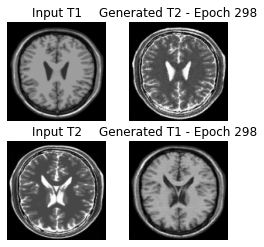

Saving checkpoint for epoch 298 at ./training_checkpoints/ckpt-298


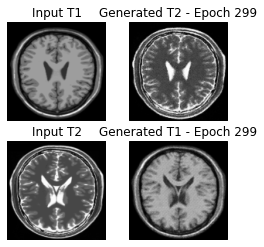

Saving checkpoint for epoch 299 at ./training_checkpoints/ckpt-299


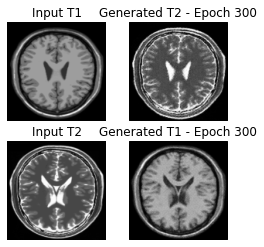

Saving checkpoint for epoch 300 at ./training_checkpoints/ckpt-300


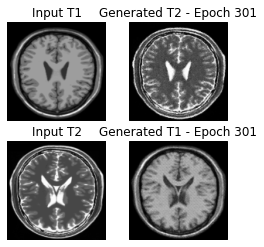

Saving checkpoint for epoch 301 at ./training_checkpoints/ckpt-301


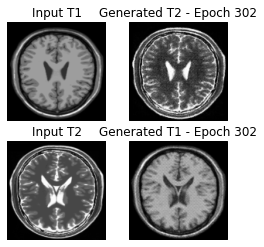

Saving checkpoint for epoch 302 at ./training_checkpoints/ckpt-302


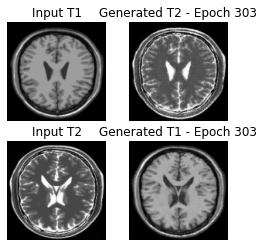

Saving checkpoint for epoch 303 at ./training_checkpoints/ckpt-303


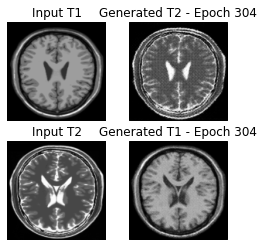

Saving checkpoint for epoch 304 at ./training_checkpoints/ckpt-304


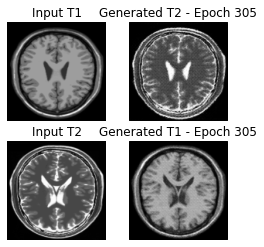

Saving checkpoint for epoch 305 at ./training_checkpoints/ckpt-305


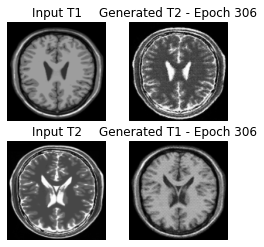

Saving checkpoint for epoch 306 at ./training_checkpoints/ckpt-306


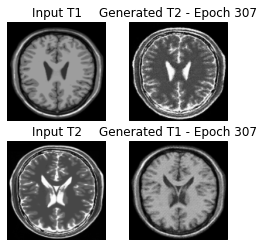

Saving checkpoint for epoch 307 at ./training_checkpoints/ckpt-307


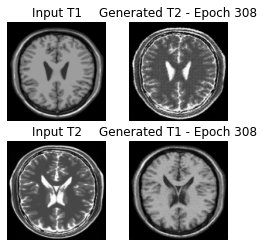

Saving checkpoint for epoch 308 at ./training_checkpoints/ckpt-308


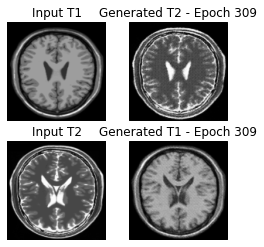

Saving checkpoint for epoch 309 at ./training_checkpoints/ckpt-309


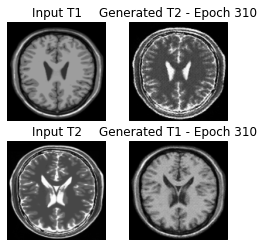

Saving checkpoint for epoch 310 at ./training_checkpoints/ckpt-310


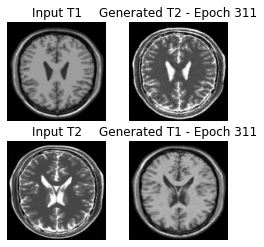

Saving checkpoint for epoch 311 at ./training_checkpoints/ckpt-311


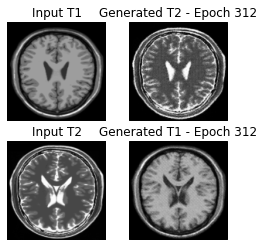

Saving checkpoint for epoch 312 at ./training_checkpoints/ckpt-312


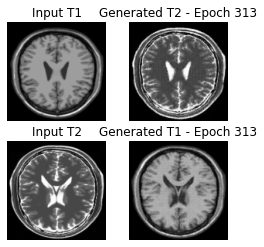

Saving checkpoint for epoch 313 at ./training_checkpoints/ckpt-313


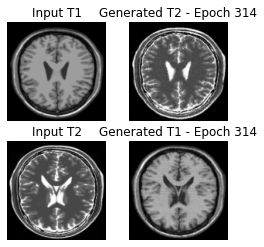

Saving checkpoint for epoch 314 at ./training_checkpoints/ckpt-314


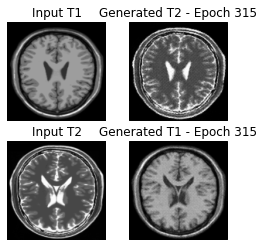

Saving checkpoint for epoch 315 at ./training_checkpoints/ckpt-315


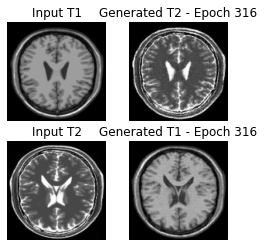

Saving checkpoint for epoch 316 at ./training_checkpoints/ckpt-316


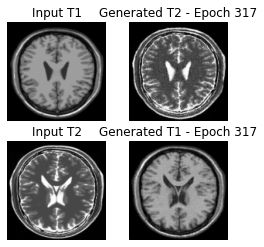

Saving checkpoint for epoch 317 at ./training_checkpoints/ckpt-317


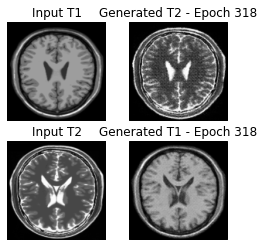

Saving checkpoint for epoch 318 at ./training_checkpoints/ckpt-318


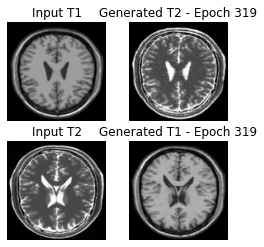

Saving checkpoint for epoch 319 at ./training_checkpoints/ckpt-319


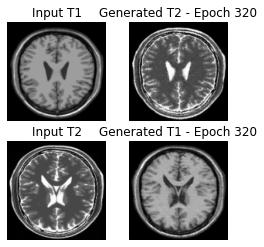

Saving checkpoint for epoch 320 at ./training_checkpoints/ckpt-320


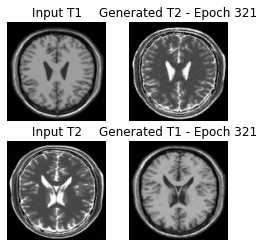

Saving checkpoint for epoch 321 at ./training_checkpoints/ckpt-321


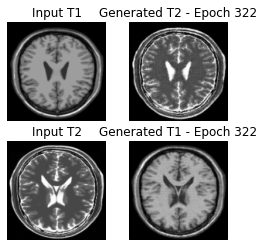

Saving checkpoint for epoch 322 at ./training_checkpoints/ckpt-322


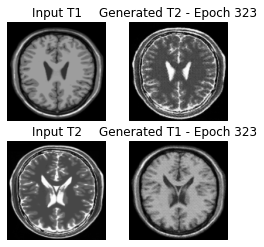

Saving checkpoint for epoch 323 at ./training_checkpoints/ckpt-323


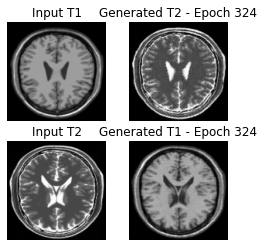

Saving checkpoint for epoch 324 at ./training_checkpoints/ckpt-324


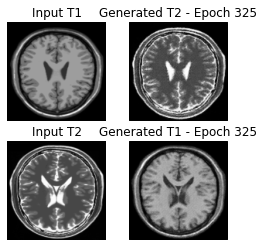

Saving checkpoint for epoch 325 at ./training_checkpoints/ckpt-325


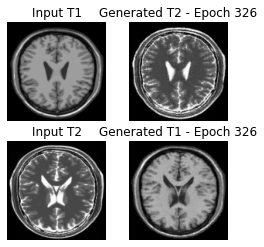

Saving checkpoint for epoch 326 at ./training_checkpoints/ckpt-326


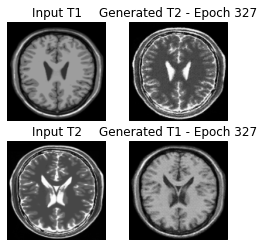

Saving checkpoint for epoch 327 at ./training_checkpoints/ckpt-327


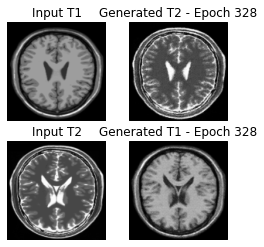

Saving checkpoint for epoch 328 at ./training_checkpoints/ckpt-328


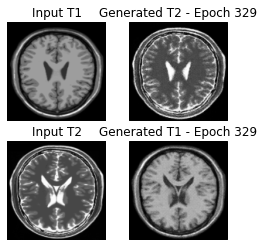

Saving checkpoint for epoch 329 at ./training_checkpoints/ckpt-329


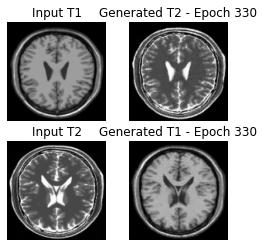

Saving checkpoint for epoch 330 at ./training_checkpoints/ckpt-330


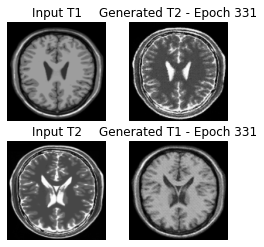

Saving checkpoint for epoch 331 at ./training_checkpoints/ckpt-331


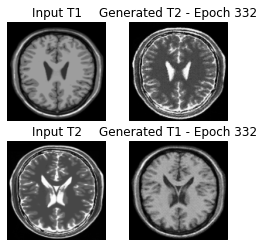

Saving checkpoint for epoch 332 at ./training_checkpoints/ckpt-332


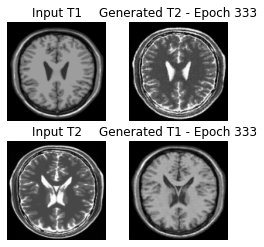

Saving checkpoint for epoch 333 at ./training_checkpoints/ckpt-333


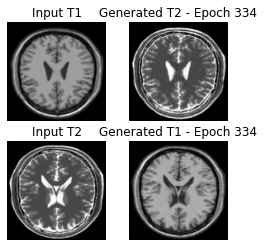

Saving checkpoint for epoch 334 at ./training_checkpoints/ckpt-334


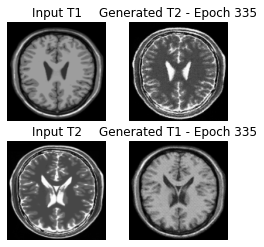

Saving checkpoint for epoch 335 at ./training_checkpoints/ckpt-335


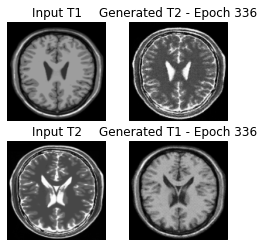

Saving checkpoint for epoch 336 at ./training_checkpoints/ckpt-336


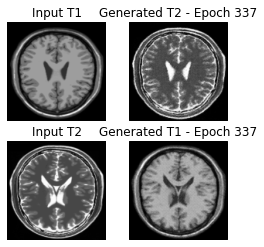

Saving checkpoint for epoch 337 at ./training_checkpoints/ckpt-337


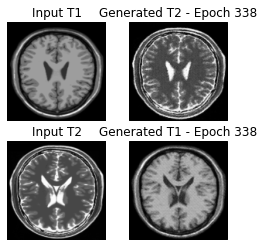

Saving checkpoint for epoch 338 at ./training_checkpoints/ckpt-338


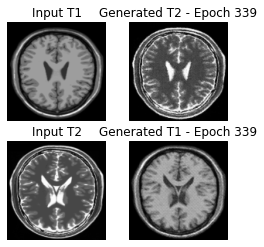

Saving checkpoint for epoch 339 at ./training_checkpoints/ckpt-339


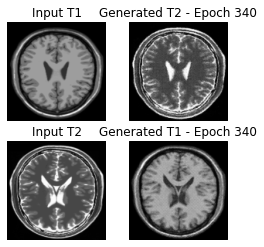

Saving checkpoint for epoch 340 at ./training_checkpoints/ckpt-340


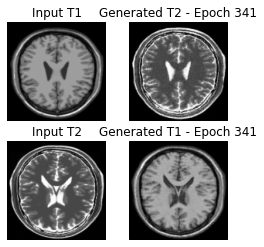

Saving checkpoint for epoch 341 at ./training_checkpoints/ckpt-341


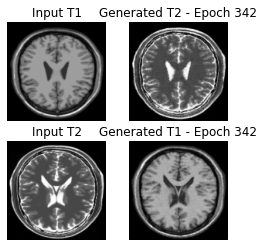

Saving checkpoint for epoch 342 at ./training_checkpoints/ckpt-342


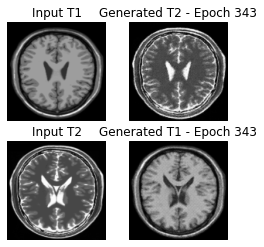

Saving checkpoint for epoch 343 at ./training_checkpoints/ckpt-343


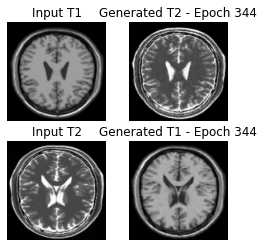

Saving checkpoint for epoch 344 at ./training_checkpoints/ckpt-344


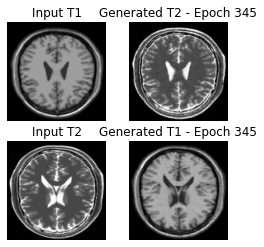

Saving checkpoint for epoch 345 at ./training_checkpoints/ckpt-345


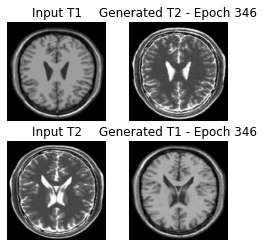

Saving checkpoint for epoch 346 at ./training_checkpoints/ckpt-346


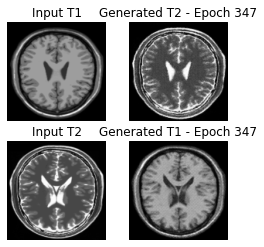

Saving checkpoint for epoch 347 at ./training_checkpoints/ckpt-347


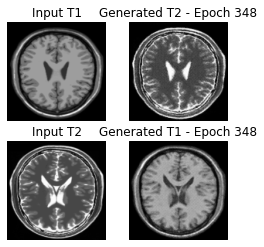

Saving checkpoint for epoch 348 at ./training_checkpoints/ckpt-348


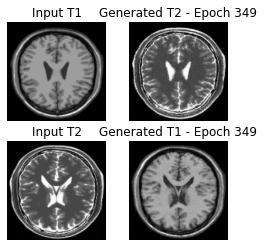

Saving checkpoint for epoch 349 at ./training_checkpoints/ckpt-349


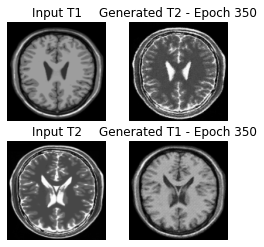

Saving checkpoint for epoch 350 at ./training_checkpoints/ckpt-350


In [99]:
# Set the number of epochs for training
EPOCHS = 350
# Alternatively, we can try using 100 or 200 epochs for faster or slower training

# Training loop - Iterating through epochs
for epoch in range(1, EPOCHS+1):
    # Iterate through images in dataset T1_data
    for image_x in T1_data:
        # Iterate through images in dataset T2_data
        for image_y in T2_data:
            # Perform a training step using the images from T1_data and T2_data
            train_step(image_x, image_y)

    # Generate images using generators for T2 and T1 domains
    generate_images(generator_T2, sample_T1_data, generator_T1, sample_T2_data, epoch)

    # Save the model checkpoint after each epoch
    ckpt_save_path = ckpt_manager.save()
    # Print a message indicating the checkpoint save location
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)


Epoch 1 - First input T1 image:


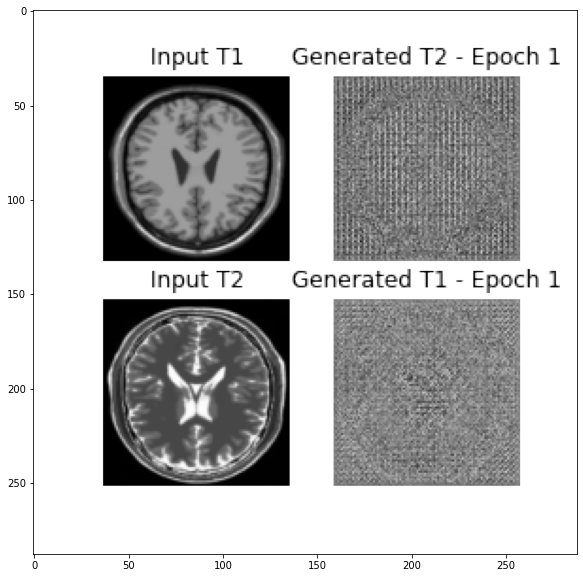

Epoch 350 - Last input T1 image:


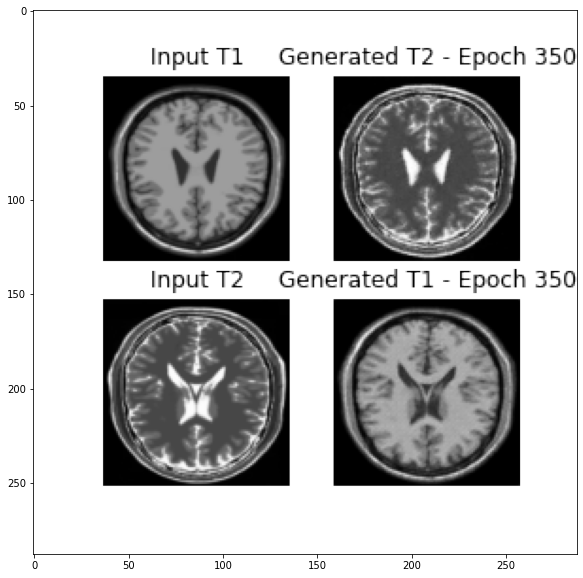

In [ ]:
# Print information for the first and last images after training
print(f"Epoch 1 - First input T1 image:")
image_path_epoch_1 = "generated_images/image_at_epoch_0001.png"
image_epoch_1 = imageio.imread(image_path_epoch_1)
plt.figure(figsize=(10, 10))  # Adjust the figsize as needed
plt.imshow(image_epoch_1, cmap='gray')
plt.axis
plt.show()

print(f"Epoch 350 - Last input T1 image:")
image_path_epoch_350 = "generated_images/image_at_epoch_0350.png"
image_epoch_350 = imageio.imread(image_path_epoch_350)
plt.figure(figsize=(10, 10))  # Adjust the figsize as needed
plt.imshow(image_epoch_350, cmap='gray')
plt.axis
plt.show()


In [3]:
# Animation file name
anim_file = 'cyclegan350.gif'

# Create an image writer for the GIF animation
with imageio.get_writer(anim_file, mode='I') as writer:
    # Get a list of generated image filenames
    filenames = glob.glob('./generated_images/image*.png')
    
    # Sort the filenames for proper sequence
    filenames = sorted(filenames)
    
    # Iterate through the sorted filenames and append each image to the GIF
    for filename in filenames:
        # Read the image from the file
        image = imageio.imread(filename)
        
        # Append the image data to the animation
        writer.append_data(image)
    
    # Repeat the last image to ensure smooth loop in the animation
    image = imageio.imread(filename)
    writer.append_data(image)


C:\Users\IPSITA\AppData\Local\Temp\ipykernel_7292\2279947084.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\IPSITA\AppData\Local\Temp\ipykernel_7292\2279947084.py:21: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [4]:
# Import necessary libraries for creating GIF
import imageio
import glob

# Set the filename for the generated GIF
anim_file = 'cyclegan350.gif'

# Create a GIF using the generated images
with imageio.get_writer(anim_file, mode='I') as writer:
    # Get the list of generated image filenames
    filenames = glob.glob('./generated_images/image*.png')
    # Sort the filenames to maintain proper order in the animation
    filenames = sorted(filenames)

    # Iterate over each filename and add the image to the GIF
    for filename in filenames:
        # Read the image from the file
        image = imageio.imread(filename)
        # Append the image data to the GIF
        writer.append_data(image)

# Display a message indicating the completion of GIF creation
print(f'GIF animation saved to: {anim_file}')


C:\Users\IPSITA\AppData\Local\Temp\ipykernel_7292\1160135758.py:18: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


GIF animation saved to: cyclegan350.gif



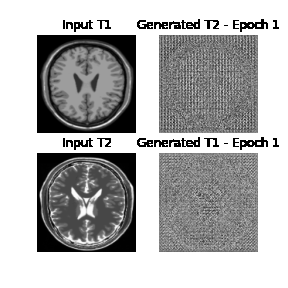

In [5]:
# Visualizing the progress from epoch to epoch
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

## Conclusion

In this notebook, we implemented a Cycle-Consistent Generative Adversarial Network (CycleGAN) for translating medical images between T1-weighted (T1) and T2-weighted (T2) magnetic resonance imaging (MRI) modalities. The model was trained for 350 epochs, and the key outcomes and applications include:

1. **Data Preprocessing:** Normalization, resizing, and reshaping of images were performed to prepare the data for effective training.

2. **Model Architecture:** A U-Net-based generator and a discriminator for each domain were defined. Instance normalization layers were incorporated to enhance the stability of model training.

3. **Loss Functions:** Binary cross-entropy loss functions were utilized for both generators and discriminators. Additional cycle consistency and identity loss functions were employed to improve translation accuracy.

4. **Optimizers:** Adam optimizers with specific learning rates were configured for the generators and discriminators to facilitate efficient model convergence.

5. **Training Loop:** The model was trained iteratively, with each epoch involving training steps on image pairs from both T1 and T2 datasets. Generated images were visualized at different stages during training.

6. **Checkpoint Management:** Checkpoints were implemented to save and restore the model's state, allowing for continued training or model evaluation.

7. **Visualization:** Sample images were generated at various epochs, providing insights into the model's learning progress.

### Application and Use Cases

The CycleGAN model finds valuable applications in the medical industry, including:

- **Data Augmentation:** Generated synthetic images can be used to augment limited datasets, improving the robustness and generalization of machine learning models.

- **Domain Adaptation:** The model facilitates adaptation between different imaging modalities, allowing for the development of models that can generalize well across various medical imaging protocols.

- **Cross-Modality Synthesis:** The ability to translate images between T1 and T2 modalities enables the synthesis of images that resemble different acquisition techniques. This is particularly useful for generating synthetic data for training models across diverse imaging settings.

- **Image Enhancement:** CycleGANs can be employed to enhance the interpretability of medical images, making them clearer and more suitable for diagnostic purposes.

- **Clinical Training:** The model can be used to create realistic training scenarios for medical professionals, helping them familiarize themselves with different imaging modalities.

These applications demonstrate the versatility and potential impact of the CycleGAN model in advancing medical image analysis, diagnosis, and healthcare research.
